In [ ]:
!pip install scikit-multilearn
!pip install opencv-python
!pip install scikit-learn
!pip install tensorflow
!pip install prettytable
!pip install dlib
!pip install seaborn
!pip install sklearn


  Using cached dlib-19.24.2.tar.gz (11.8 MB)
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
Failed to build dlib


  error: subprocess-exited-with-error
  
  × Building wheel for dlib (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> [73 lines of output]
      running bdist_wheel
      running build
      running build_ext
      <string>:125: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
      Building extension for Python 3.9.18 (main, Sep 11 2023, 14:09:26) [MSC v.1916 64 bit (AMD64)]
      Invoking CMake setup: 'cmake C:\Users\Project\AppData\Local\Temp\pip-install-rw4can0m\dlib_e3552c354f734ea89bcef484ce113a68\tools\python -DCMAKE_LIBRARY_OUTPUT_DIRECTORY=C:\Users\Project\AppData\Local\Temp\pip-install-rw4can0m\dlib_e3552c354f734ea89bcef484ce113a68\build\lib.win-amd64-cpython-39 -DPYTHON_EXECUTABLE=C:\Users\Project\anaconda3\envs\my_env\python.exe -DCMAKE_LIBRARY_OUTPUT_DIRECTORY_RELEASE=C:\Users\Project\AppData\Local\Temp\pip-install-rw4can0m\dlib_e3552c354f734ea89bcef484ce113a68\build\lib.win-amd64-cpython-39 -A x64'
      -- Buil

  Using cached sklearn-0.0.post12.tar.gz (2.6 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'error'


  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> [15 lines of output]
      The 'sklearn' PyPI package is deprecated, use 'scikit-learn'
      rather than 'sklearn' for pip commands.
      
      Here is how to fix this error in the main use cases:
      - use 'pip install scikit-learn' rather than 'pip install sklearn'
      - replace 'sklearn' by 'scikit-learn' in your pip requirements files
        (requirements.txt, setup.py, setup.cfg, Pipfile, etc ...)
      - if the 'sklearn' package is used by one of your dependencies,
        it would be great if you take some time to track which package uses
        'sklearn' instead of 'scikit-learn' and report it to their issue tracker
      - as a last resort, set the environment variable
        SKLEARN_ALLOW_DEPRECATED_SKLEARN_PACKAGE_INSTALL=True to avoid this error
      
      More information is available at
      https://github.com/scikit-learn/sklearn-pypi-packag

In [ ]:
import os
import cv2
import time
import pickle
import sklearn
import cvlib as cv
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
import matplotlib.pyplot as plt



from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, InputLayer, GlobalAveragePooling2D
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from tensorflow.keras.applications import ResNet50, InceptionResNetV2, MobileNetV2, VGG16
from sklearn.model_selection import train_test_split,cross_val_score,KFold
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
from tensorflow.keras.applications import ResNet50,InceptionResNetV2
from tensorflow.keras.optimizers.schedules import ExponentialDecay
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from skmultilearn.model_selection import IterativeStratification
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.applications import MobileNetV2
from sklearn.model_selection import StratifiedKFold
from tensorflow.keras.layers import Flatten, Dense
from sklearn.metrics import classification_report
from tensorflow.keras.applications import VGG16
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.models import Model
from tensorflow.keras import optimizers
from keras.utils import to_categorical
from prettytable import PrettyTable






def custom_hamming_loss(y_true, y_pred):
    return hamming_loss(y_true, y_pred)

def custom_accuracy_score(y_true, y_pred):
    return sk_accuracy_score(y_true, y_pred)

# Import Data From Gooogle Drive

In [ ]:
path = r"E:/finaldata"
foldersname = ['fake', 'real']

# Data Balance

In [ ]:
# Get the list of items in the directory
fake_items = os.listdir("E:/finaldata/fake")
fake_num_items = len(fake_items)  # Get the number of items

print(f"Number of Fake Videos: {fake_num_items}")

Number of Fake Videos: 1000


In [ ]:
# Get the list of items in the directory
real_items = os.listdir("E:/finaldata/real")
real_num_items = len(real_items)  # Get the number of items

print(f"Number of Real Videos: {real_num_items}")

Number of Real Videos: 1000


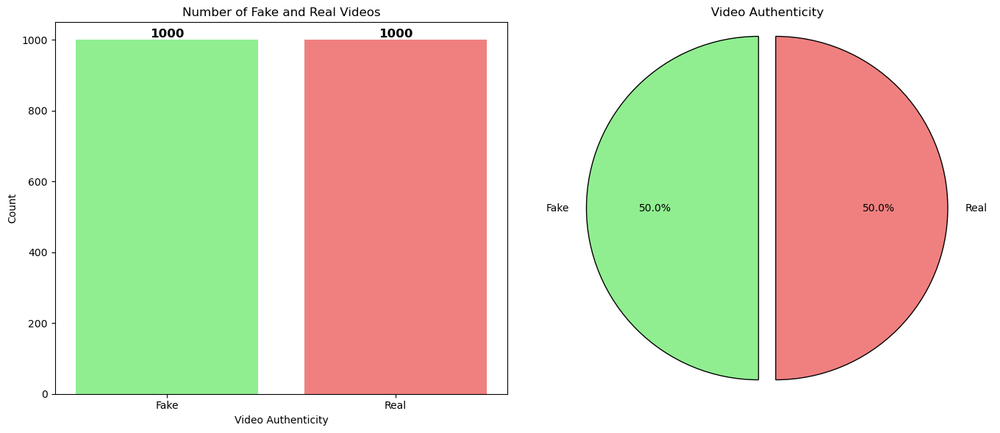

In [ ]:
# Define the counts of fake and real videos
videos_counts = [fake_num_items, real_num_items]
videos_labels = ['Fake', 'Real']
colors = ['lightgreen', 'lightcoral']

# Create a figure with one row and two columns for side-by-side plots
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Plot the bar chart on the first subplot
axes[0].bar(videos_labels, videos_counts, color=colors)
for i, v in enumerate(videos_counts):
    axes[0].text(i, v, str(v), ha='center', va='bottom', fontweight='bold', fontsize=12)

axes[0].set_title('Number of Fake and Real Videos')
axes[0].set_xlabel('Video Authenticity')
axes[0].set_ylabel('Count')

# Create a pie chart on the second subplot
axes[1].pie(videos_counts, labels=videos_labels, autopct='%1.1f%%', startangle=90, explode=(0.1, 0), colors=colors,
           wedgeprops={'edgecolor': 'black', 'linewidth': 1, 'antialiased': True})
axes[1].set_title('Video Authenticity')
axes[1].axis('equal')  # Equal aspect ratio ensures that the pie is drawn as a circle.

# Adjust the layout and display the plots
plt.tight_layout()
plt.show()

# Preprossing

## Get N Frame every T sec

 `process_videos(frameTime)` reads multiple video files from specified folders, capturing frames at regular intervals (`frameTime` seconds). It extracts frames, resizes them to 128x128 pixels, and creates a Pandas DataFrame containing frame data with columns for 'VideoID', 'FrameID', 'Frames' (frame images), and 'Label' (video labels). It prints statistics including the capture interval, total videos processed, total frames extracted, and the average frames extracted per video. This function enables efficient frame extraction and organization for video analysis tasks, providing essential information about the processed videos and their frames.

In [ ]:
def process_videos(frameTime):
    # Initialize lists to store frame data, video IDs, and frame IDs
    labels = []
    ListFrames = []
    video_ids = []
    frame_ids = []

    total_videos = -1  # Initialize the counter for total videos

    # Iterate through each folder containing videos
    for foldername in foldersname:
        folder_path = os.path.join(path, foldername)  # Create the path to the video folder
        for filename in os.listdir(folder_path):
            if filename.endswith(".mp4"):
                total_videos += 1  # Increment the counter for each video found
                video_path = os.path.join(folder_path, filename)
                cap = cv2.VideoCapture(video_path)
                frame_rate = cap.get(cv2.CAP_PROP_FPS)  # Get the video's frame rate
                frame_interval = int(frame_rate * frameTime)  # Calculate the frame capture interval

                frame_counter = 0
                video_frame_ids = 0

                while True:
                    ret, frame = cap.read()
                    if not ret:
                        break  # Break if there are no more frames

                    frame_counter += 1  #

                    # Capture frames at the specified interval
                    if frame_counter % frame_interval == 0:
                        frame = cv2.resize(frame, (128, 128))  # Resize frames to 128x128
                        ListFrames.append(frame)
                        labels.append(foldername)
                        video_ids.append(total_videos)
                        frame_ids.append(video_frame_ids)
                        video_frame_ids += 1  # Increment frame ID for the video

                cap.release()  # Release video capture object after processing

    # Create a DataFrame from collected data
    data = {
        'VideoID': video_ids,
        'FrameID': frame_ids,
        'Frames': ListFrames,
        'Label': labels
    }
    df = pd.DataFrame(data)

    # Print summary information
    print(f"Capture one frame every {frameTime} seconds")
    print(f"Total number of videos: {total_videos}")
    print(f"Total number of frames: {len(df)}")
    print(f"Average frames per video: {len(df) / total_videos}")

    return df  # Return the DataFrame containing video frame information


### After 1 sec

In [ ]:
df_1sec= process_videos(1)

Capture one frame every 1 seconds
Total number of videos: 1999
Total number of frames: 16370
Average frames per video: 8.189094547273637


In [ ]:
df_1sec

,VideoID,FrameID,Frames,Label
0,0,0,"[[[0, 0, 4], [1, 0, 1], [1, 1, 4], [1, 1, 4], ...",fake
1,0,1,"[[[2, 0, 3], [1, 0, 2], [1, 1, 3], [1, 1, 5], ...",fake
2,0,2,"[[[2, 0, 4], [0, 0, 2], [0, 1, 3], [0, 1, 4], ...",fake
3,0,3,"[[[2, 0, 3], [0, 0, 4], [0, 0, 2], [0, 1, 3], ...",fake
4,0,4,"[[[0, 0, 3], [0, 0, 2], [1, 0, 3], [1, 1, 5], ...",fake
...,...,...,...,...
16365,1999,19,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real
16366,1999,20,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real
16367,1999,21,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real
16368,1999,22,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real


### After 2 sec

In [ ]:
df_2sec = process_videos(2)

Capture one frame every 2 seconds
Total number of videos: 1999
Total number of frames: 7965
Average frames per video: 3.9844922461230614


In [ ]:
df_2sec

,VideoID,FrameID,Frames,Label
0,0,0,"[[[2, 0, 3], [1, 0, 2], [1, 1, 3], [1, 1, 5], ...",fake
1,0,1,"[[[2, 0, 3], [0, 0, 4], [0, 0, 2], [0, 1, 3], ...",fake
2,0,2,"[[[1, 0, 2], [1, 0, 3], [1, 0, 2], [1, 1, 5], ...",fake
3,1,0,"[[[45, 50, 33], [56, 63, 46], [34, 39, 22], [6...",fake
4,1,1,"[[[45, 49, 36], [53, 59, 45], [32, 38, 19], [6...",fake
...,...,...,...,...
7960,1999,7,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real
7961,1999,8,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real
7962,1999,9,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real
7963,1999,10,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real


### After 4 sec

In [ ]:
df_4sec= process_videos(4)

Capture one frame every 4 seconds
Total number of videos: 1999
Total number of frames: 3258
Average frames per video: 1.629814907453727


In [ ]:
df_4sec

,VideoID,FrameID,Frames,Label
0,0,0,"[[[2, 0, 3], [0, 0, 4], [0, 0, 2], [0, 1, 3], ...",fake
1,1,0,"[[[45, 49, 36], [53, 59, 45], [32, 38, 19], [6...",fake
2,2,0,"[[[12, 23, 43], [14, 25, 45], [15, 24, 44], [1...",fake
3,3,0,"[[[74, 62, 61], [76, 64, 63], [76, 64, 63], [7...",fake
4,4,0,"[[[13, 9, 23], [11, 8, 22], [10, 7, 21], [11, ...",fake
...,...,...,...,...
3253,1999,1,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real
3254,1999,2,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real
3255,1999,3,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real
3256,1999,4,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real


## Recognize Faces

The `show_detection` function processes a collection of images, organizing them into a grid with rows representing different labels. Utilizing the cvlib library's cv.detect_face method, the function resizes each image, detects faces, and draws rectangles around them. The modified images, showcasing identified faces, are displayed using Matplotlib.

In [ ]:
def show_detection(images,cols=5):

    total_frames = len(images)
    rows = (total_frames + cols - 1) // cols  # Calculate the number of rows dynamically
    print(rows)
    total_subplots = rows * cols
    print(total_subplots)

    fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))



    for i, image in enumerate(images):

        ax = axes[i // cols, i % cols] if rows > 1 else axes[i % cols]
        """Draws a rectangle over each detected face"""
        # faces contains a list of mmod_rectangle objects
        # The mmod_rectangle object has two member variables, a dlib.rectangle object, and a confidence score
        # Therefore, we iterate over the detected mmod_rectangle objects accessing dlib.rect to draw the rectangle
        image = cv2.resize(image, (300, 300))

        faces, confidences = cv.detect_face(image)

        for (x, y, w, h) in faces:
            cv2.rectangle(image, (x, y), (w,  h), (255, 0, 0), 2)

        ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
        ax.axis('off')


    for i in range(total_frames, total_subplots):
        axes.flatten()[i].axis('off')

    plt.tight_layout()
    plt.show()

### After 1 sec

In [ ]:
df_1sec['Frames']

0        [[[0, 0, 4], [1, 0, 1], [1, 1, 4], [1, 1, 4], ...
1        [[[2, 0, 3], [1, 0, 2], [1, 1, 3], [1, 1, 5], ...
2        [[[2, 0, 4], [0, 0, 2], [0, 1, 3], [0, 1, 4], ...
3        [[[2, 0, 3], [0, 0, 4], [0, 0, 2], [0, 1, 3], ...
4        [[[0, 0, 3], [0, 0, 2], [1, 0, 3], [1, 1, 5], ...
                               ...                        
16365    [[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...
16366    [[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...
16367    [[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...
16368    [[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...
16369    [[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...
Name: Frames, Length: 16370, dtype: object

20
100


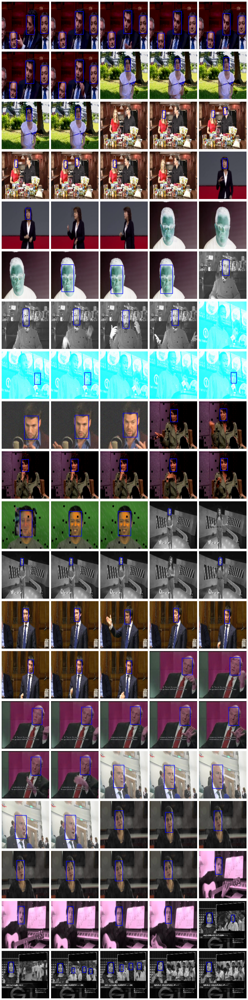

In [ ]:
detected_frame_1sec=show_detection(df_1sec['Frames'][:100],cols=5)
detected_frame_1sec

### After 2 sec

20
100


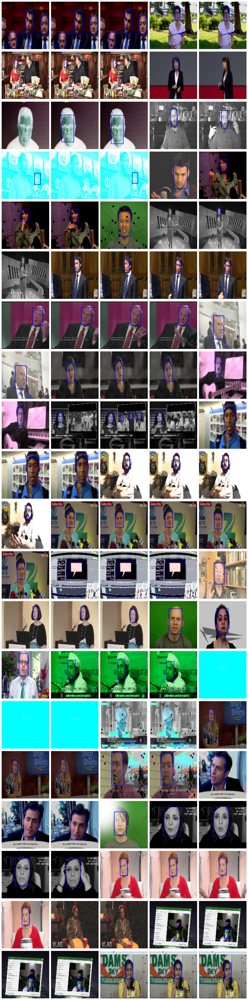

In [ ]:
detected_frame_2sec=show_detection(df_2sec['Frames'][:100],cols=5)
detected_frame_2sec

### After 4 sec

20
100


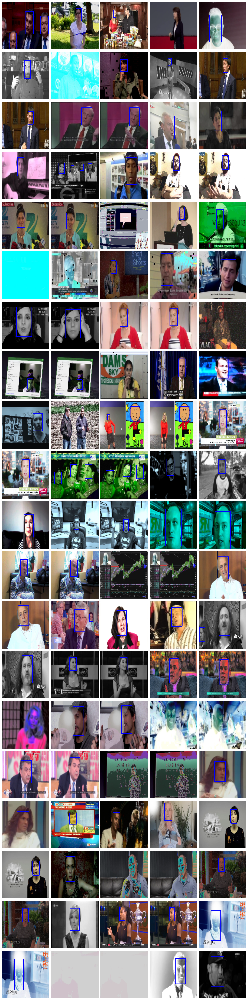

In [ ]:
detected_frame_4sec=show_detection(df_4sec['Frames'][:100],cols=5)
detected_frame_4sec

## Normalization & Label Encoder


The `preprocess_data` function normalizes pixel values of image data within the DataFrame `df` to a range of [0, 1]. It encodes the labels using `LabelEncoder` and converts them into one-hot encoded categorical format using `to_categorical` from Keras. The function then adds two new columns, 'Normalized Frames' containing the normalized image data and 'Categorical Labels' containing the one-hot encoded categorical labels, to the existing DataFrame `df`, enhancing it with preprocessed image and label data for subsequent tasks without creating a new DataFrame. Adjust column names accordingly to suit the DataFrame's structure.

In [ ]:
def preprocess_data(df):
    np_ListFrames = np.array(df['Frames'])
    np_Labels = np.array(df['Label'])

    # Normalize the pixel values to be in the range [0, 1]
    np_ListFrames = np_ListFrames / 255.0

    # Label Encoding
    label_encoder = LabelEncoder()
    labels_encoded = label_encoder.fit_transform(np_Labels)

    # Convert to one-hot encoded categorical labels
    y = to_categorical(labels_encoded)

    # Add new columns to the existing DataFrame
    df['Normalized Frames'] = np_ListFrames
    df['Categorical Labels'] = list(y)

    return df

### After 1 sec

In [ ]:
df_1sec= preprocess_data(df_1sec)

In [ ]:
df_1sec

,VideoID,FrameID,Frames,Label,Normalized Frames,Categorical Labels
0,0,0,"[[[0, 0, 4], [1, 0, 1], [1, 1, 4], [1, 1, 4], ...",fake,"[[[0.0, 0.0, 0.01568627450980392], [0.00392156...","[1.0, 0.0]"
1,0,1,"[[[2, 0, 3], [1, 0, 2], [1, 1, 3], [1, 1, 5], ...",fake,"[[[0.00784313725490196, 0.0, 0.011764705882352...","[1.0, 0.0]"
2,0,2,"[[[2, 0, 4], [0, 0, 2], [0, 1, 3], [0, 1, 4], ...",fake,"[[[0.00784313725490196, 0.0, 0.015686274509803...","[1.0, 0.0]"
3,0,3,"[[[2, 0, 3], [0, 0, 4], [0, 0, 2], [0, 1, 3], ...",fake,"[[[0.00784313725490196, 0.0, 0.011764705882352...","[1.0, 0.0]"
4,0,4,"[[[0, 0, 3], [0, 0, 2], [1, 0, 3], [1, 1, 5], ...",fake,"[[[0.0, 0.0, 0.011764705882352941], [0.0, 0.0,...","[1.0, 0.0]"
...,...,...,...,...,...,...
16365,1999,19,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"
16366,1999,20,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"
16367,1999,21,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"
16368,1999,22,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"


### After 2 sec

In [ ]:
df_2sec=preprocess_data(df_2sec)

In [ ]:
df_2sec

,VideoID,FrameID,Frames,Label,Normalized Frames,Categorical Labels
0,0,0,"[[[2, 0, 3], [1, 0, 2], [1, 1, 3], [1, 1, 5], ...",fake,"[[[0.00784313725490196, 0.0, 0.011764705882352...","[1.0, 0.0]"
1,0,1,"[[[2, 0, 3], [0, 0, 4], [0, 0, 2], [0, 1, 3], ...",fake,"[[[0.00784313725490196, 0.0, 0.011764705882352...","[1.0, 0.0]"
2,0,2,"[[[1, 0, 2], [1, 0, 3], [1, 0, 2], [1, 1, 5], ...",fake,"[[[0.00392156862745098, 0.0, 0.007843137254901...","[1.0, 0.0]"
3,1,0,"[[[45, 50, 33], [56, 63, 46], [34, 39, 22], [6...",fake,"[[[0.17647058823529413, 0.19607843137254902, 0...","[1.0, 0.0]"
4,1,1,"[[[45, 49, 36], [53, 59, 45], [32, 38, 19], [6...",fake,"[[[0.17647058823529413, 0.19215686274509805, 0...","[1.0, 0.0]"
...,...,...,...,...,...,...
7960,1999,7,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"
7961,1999,8,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"
7962,1999,9,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"
7963,1999,10,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"


### After 4 sec

In [ ]:
df_4sec=preprocess_data(df_4sec)

In [ ]:
df_4sec

,VideoID,FrameID,Frames,Label,Normalized Frames,Categorical Labels
0,0,0,"[[[2, 0, 3], [0, 0, 4], [0, 0, 2], [0, 1, 3], ...",fake,"[[[0.00784313725490196, 0.0, 0.011764705882352...","[1.0, 0.0]"
1,1,0,"[[[45, 49, 36], [53, 59, 45], [32, 38, 19], [6...",fake,"[[[0.17647058823529413, 0.19215686274509805, 0...","[1.0, 0.0]"
2,2,0,"[[[12, 23, 43], [14, 25, 45], [15, 24, 44], [1...",fake,"[[[0.047058823529411764, 0.09019607843137255, ...","[1.0, 0.0]"
3,3,0,"[[[74, 62, 61], [76, 64, 63], [76, 64, 63], [7...",fake,"[[[0.2901960784313726, 0.24313725490196078, 0....","[1.0, 0.0]"
4,4,0,"[[[13, 9, 23], [11, 8, 22], [10, 7, 21], [11, ...",fake,"[[[0.050980392156862744, 0.03529411764705882, ...","[1.0, 0.0]"
...,...,...,...,...,...,...
3253,1999,1,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"
3254,1999,2,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"
3255,1999,3,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"
3256,1999,4,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",real,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,...","[0.0, 1.0]"


## Spliting Data

### After 1 sec

In [ ]:
# Splitting into train and test sets (80% train, 20% test)
X_train_1sec, X_test_temp_1sec, y_train_1sec, y_test_temp_1sec = train_test_split(
    df_1sec[['VideoID', 'FrameID', 'Normalized Frames']],
    df_1sec['Categorical Labels'],
    test_size=0.2,
    random_state=42
)

# Further splitting the test set into test and validation sets (50% test, 50% validation)
X_test_1sec, X_val_1sec, y_test_1sec, y_val_1sec = train_test_split(
    X_test_temp_1sec,
    y_test_temp_1sec,
    test_size=0.5,
    random_state=42
)


### After 2 sec

In [ ]:
# Split into train and test sets (80% train, 20% test)
X_train_2sec, X_test_2sec, y_train_2sec, y_test_2sec = train_test_split(
    df_2sec[['VideoID','FrameID','Normalized Frames']],
    df_2sec['Categorical Labels'],
    test_size=0.2,
    random_state=42
    )

# Further split the test set into test and validation sets (50% test, 50% validation)
X_test_2sec, X_val_2sec, y_test_2sec, y_val_2sec = train_test_split(
    X_test_2sec,
    y_test_2sec,
    test_size=0.5, random_state=42
    )

### After 4 sec

In [ ]:
# Split into train and test sets (80% train, 20% test)
X_train_4sec, X_test_4sec, y_train_4sec, y_test_4sec =train_test_split(
    df_4sec[['VideoID','FrameID','Normalized Frames']],
    df_4sec['Categorical Labels'],
    test_size=0.2,
    random_state=42
    )

# Further split the test set into test and validation sets (50% test, 50% validation)
X_test_4sec, X_val_4sec, y_test_4sec, y_val_4sec = train_test_split(
    X_test_4sec,
    y_test_4sec,
    test_size=0.5,
    random_state=42
    )

## Convert to Tensor

In [ ]:
# Convert the frame data and labels for videos into TensorFlow tensors for training, validation, and testing sets

X_train_1secT = tf.convert_to_tensor(np.array(X_train_1sec['Normalized Frames'].tolist()), dtype=tf.float32)
X_val_1secT =  tf.convert_to_tensor(np.array(X_val_1sec['Normalized Frames'].tolist()), dtype=tf.float32)
X_test_1secT = tf.convert_to_tensor(np.array(X_test_1sec['Normalized Frames'].tolist()), dtype=tf.float32)

y_train_1secT = tf.convert_to_tensor(np.array(y_train_1sec.tolist()), dtype=tf.float32)
y_val_1secT =  tf.convert_to_tensor(np.array(y_val_1sec.tolist()), dtype=tf.float32)
y_test_1secT = tf.convert_to_tensor(np.array(y_test_1sec.tolist()), dtype=tf.float32)

In [ ]:
X_train_2secT = tf.convert_to_tensor(np.array(X_train_2sec['Normalized Frames'].tolist()), dtype=tf.float32)
X_val_2secT =  tf.convert_to_tensor(np.array(X_val_2sec['Normalized Frames'].tolist()), dtype=tf.float32)
X_test_2secT = tf.convert_to_tensor(np.array(X_test_2sec['Normalized Frames'].tolist()), dtype=tf.float32)

y_train_2secT = tf.convert_to_tensor(np.array(y_train_2sec.tolist()), dtype=tf.float32)
y_val_2secT =  tf.convert_to_tensor(np.array(y_val_2sec.tolist()), dtype=tf.float32)
y_test_2secT = tf.convert_to_tensor(np.array(y_test_2sec.tolist()), dtype=tf.float32)

In [ ]:
X_train_4secT = tf.convert_to_tensor(np.array(X_train_4sec['Normalized Frames'].tolist()), dtype=tf.float32)
X_val_4secT =  tf.convert_to_tensor(np.array(X_val_4sec['Normalized Frames'].tolist()), dtype=tf.float32)
X_test_4secT = tf.convert_to_tensor(np.array(X_test_4sec['Normalized Frames'].tolist()), dtype=tf.float32)

y_train_4secT = tf.convert_to_tensor(np.array(y_train_4sec.tolist()), dtype=tf.float32)
y_val_4secT =  tf.convert_to_tensor(np.array(y_val_4sec.tolist()), dtype=tf.float32)
y_test_4secT = tf.convert_to_tensor(np.array(y_test_4sec.tolist()), dtype=tf.float32)


# Modeling

In [ ]:
epochs=100
batch_size=32

## Helper Functions

`create_video_data` uses a provided model to predict labels for a given dataset (`x`). It computes the actual and predicted labels, stores them alongside corresponding VideoID and FrameID from the input data `X`, and calculates the loss using `model.evaluate`. Finally, it returns a DataFrame containing video data with VideoID, FrameID, Actual Label, and Predicted Label, along with the computed loss.

In [ ]:
def create_video_data(model,X, x, y_true):
    actual_labels =  np.argmax(y_true, axis=1)
    y_pred = model.predict(x)
    predicted_labels = np.argmax(y_pred, axis=1)

    # Calculate loss using model.evaluate
    loss = model.evaluate(x, y_true, verbose=0)[0]

    return pd.DataFrame({'VideoID': X['VideoID'],'FrameID': X['FrameID'], 'Actual Label': actual_labels, 'Predicted Label': predicted_labels}), loss

 `calculate_video_confusion_matrix` processes video data by categorizing videos as 'Real' or 'Fake' based on predicted label percentages. It constructs a DataFrame per video, detailing frame count, actual label, model decision, and predicted label counts ('Fake' and 'Real'). The function generates a confusion matrix and computes accuracy, precision, recall, and F1-score, evaluating the model's video-level performance. Ultimately, it presents insights into video categorization and assesses the model's predictive quality.

In [ ]:
def calculate_video_confusion_matrix(video_data):
    # Extract unique video IDs from the provided video data
    unique_videos = video_data['VideoID'].unique()
    results = []  # Initialize an empty list to store results for each video

    # Loop through each unique video ID
    for vid in unique_videos:
        # Extract data subset for the current video ID
        video_subset = video_data[video_data['VideoID'] == vid]

        # Count the occurrences of predicted labels for the video subset
        counts = video_subset['Predicted Label'].value_counts()
        count_1 = counts.get(1, 0)  # Get the count of label '1'

        # Determine the model decision ('Real' or 'Fake') based on label proportions
        total_count = len(video_subset)
        if count_1 / total_count >= 0.7:
            X = 1  # Model decision: 'Real'
        else:
            X = 0  # Model decision: 'Fake'

        # Retrieve video-related information such as frame counts, actual labels, and predicted counts
        num_frames = len(video_subset)
        actual_label = video_subset['Actual Label'].iloc[0]  # Taking the actual label from the first frame
        fake_count = len(video_subset[video_subset['Predicted Label'] == 0])
        real_count = len(video_subset[video_subset['Predicted Label'] == 1])

        # Create a DataFrame containing information for the current video
        new_data = {
            'VideoID': [vid],
            'Number of Frames': [num_frames],
            'Actual Label': [actual_label],
            'Model Decision': [X],
            'Predicted Fake Count': [fake_count],
            'Predicted Real Count': [real_count]
        }
        new_df = pd.DataFrame(new_data)

        results.append(new_df)  # Append DataFrame to results list for each video

    # Concatenate all DataFrames into a single DataFrame
    final_result = pd.concat(results, ignore_index=True)
    final_result = final_result.sort_values(by='VideoID', ascending=True)  # Sort by VideoID in ascending order

    # Generate a confusion matrix based on actual and model decisions
    conf_matrix = confusion_matrix(final_result['Actual Label'], final_result['Model Decision'])

    # Calculate evaluation metrics (Accuracy, Precision, Recall, F1 Score)
    accuracy = accuracy_score(final_result['Actual Label'], final_result['Model Decision'])
    precision = precision_score(final_result['Actual Label'], final_result['Model Decision'])
    recall = recall_score(final_result['Actual Label'], final_result['Model Decision'])
    f1 = f1_score(final_result['Actual Label'], final_result['Model Decision'])

    return final_result, conf_matrix, accuracy, f1


`evaluate_model_video_level` assesses a model's performance at the video level across training, validation, and test sets. It utilizes `create_video_data` to generate video-specific predictions and losses. Then, it employs `calculate_video_confusion_matrix` to compute metrics (confusion matrix, accuracy, F1-score) for each dataset. This function organizes and presents these results comprehensively in a dictionary structure. Lastly, it displays video-level results and confusion matrices for the training, validation, and test sets in separate visualizations.

In [ ]:
def evaluate_model_video_level(model, train, valid, test, X_train, y_train, X_val, y_val, X_test, y_test):
    # Generate video data and associated loss for training, validation, and test sets
    video_data_train, train_loss = create_video_data(model, train, X_train, y_train)
    video_data_val, val_loss = create_video_data(model, valid, X_val, y_val)
    video_data_test, test_loss = create_video_data(model, test, X_test, y_test)

    # Calculate confusion matrix, accuracy, and F1-score for training, validation, and test sets
    train_final_result, train_confusion_matrix, train_accuracy, train_f1 = calculate_video_confusion_matrix(video_data_train)
    val_final_result, val_confusion_matrix, val_accuracy, val_f1 = calculate_video_confusion_matrix(video_data_val)
    test_final_result, test_confusion_matrix, test_accuracy, test_f1 = calculate_video_confusion_matrix(video_data_test)

    # Aggregate evaluation results for training, validation, and test sets
    results = {
        'Training': {
            'Final Results': train_final_result,
            'Confusion Matrix': train_confusion_matrix,
            'Accuracy': train_accuracy,
            'F1 Score': train_f1,
            'Loss': train_loss
        },
        'Validation': {
            'Final Results': val_final_result,
            'Confusion Matrix': val_confusion_matrix,
            'Accuracy': val_accuracy,
            'F1 Score': val_f1,
            'Loss': val_loss
        },
        'Test': {
            'Final Results': test_final_result,
            'Confusion Matrix': test_confusion_matrix,
            'Accuracy': test_accuracy,
            'F1 Score': test_f1,
            'Loss': test_loss
        }
    }

    # Display evaluation metrics and confusion matrices for training, validation, and test sets
    print("Training Set:")
    display(train_final_result)
    print("\nValidation Set:")
    display(val_final_result)
    print("\nTest Set:")
    display(test_final_result)

    # Plotting Confusion Matrices for training, validation, and test sets
    fig, axs = plt.subplots(1, 3, figsize=(18, 5))
    # Heatmap for Training Confusion Matrix
    sns.heatmap(train_confusion_matrix, annot=True, cmap='Pastel2', ax=axs[0], fmt='g')
    axs[0].set_title('Training Confusion Matrix')
    axs[0].set_xlabel('Predicted Labels')
    axs[0].set_ylabel('Actual Labels')

    # Heatmap for Validation Confusion Matrix
    sns.heatmap(val_confusion_matrix, annot=True, cmap='Pastel1', ax=axs[1], fmt='g')
    axs[1].set_title('Validation Confusion Matrix')
    axs[1].set_xlabel('Predicted Labels')
    axs[1].set_ylabel('Actual Labels')

    # Heatmap for Testing Confusion Matrix
    sns.heatmap(test_confusion_matrix, annot=True, cmap='Pastel2', ax=axs[2], fmt='g')
    axs[2].set_title('Testing Confusion Matrix')
    axs[2].set_xlabel('Predicted Labels')
    axs[2].set_ylabel('Actual Labels')

    # Adjust layout for better visualization
    plt.tight_layout()
    plt.show()

    return results


 `plot_training_history` visualizes the training history of a neural network model stored in the `history` object. It creates a figure with two subplots, where the first subplot displays the training and validation accuracy across epochs, and the second subplot shows the training and validation loss. These visualizations help analyze the model's performance and identify potential overfitting or underfitting issues during training.

In [ ]:
def plot_training_history(history):
    # Create a figure for visualizing training history metrics
    plt.figure(figsize=(15, 6))

    # Subplot 1: Accuracy - Train vs Validation
    plt.subplot(1, 2, 1)
    plt.plot(range(1, len(history.history['accuracy']) + 1), history.history['accuracy'], label='Train Accuracy')
    plt.plot(range(1, len(history.history['val_accuracy']) + 1), history.history['val_accuracy'], label='Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title('Accuracy - Train vs Validation')
    plt.legend()

    # Subplot 2: Loss - Train vs Validation
    plt.subplot(1, 2, 2)
    plt.plot(range(1, len(history.history['loss']) + 1), history.history['loss'], label='Train Loss')
    plt.plot(range(1, len(history.history['val_loss']) + 1), history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Loss - Train vs Validation')
    plt.legend()

    # Adjust layout for better visualization
    plt.tight_layout()
    plt.show()



## Resnet50 Model

`ResnetModel_Model` constructs a ResNet50-based neural network for image classification. It initializes a pre-trained ResNet50 model without its top layer, adds a Global Average Pooling layer, two Dense layers (512 units with ReLU activation and 2 units with softmax activation), and creates a new model from these layers. The function compiles the model using the Adam optimizer with a specific learning rate, categorical cross-entropy loss, and accuracy metrics. It then trains the model on the provided training data (`X_train`, `y_train`) while validating on the validation data (`X_val`, `y_val`) for a specified number of epochs (`epochs`) and batch size (`batch_size`), returning the trained model and its training history.

In [ ]:
def ResnetModel_Model(X_train, y_train, X_val, y_val, X_test, y_test, epochs=epochs, batch_size=batch_size):
    # Load the ResNet50 model pre-trained on ImageNet without the top layers
    resnet_model = ResNet50(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

    # Add custom classification layers on top of ResNet50
    x = GlobalAveragePooling2D()(resnet_model.output)
    x = Dense(512, activation='relu')(x)
    x = Dropout(0.5)(x)  # Add dropout with a dropout rate of 0.5
    x = Dense(2, activation='softmax')(x)

    # Create a new model by combining ResNet50 base and custom classification layers
    model = Model(inputs=resnet_model.input, outputs=x)

    # Configure optimizer with a specific learning rate
    custom_optimizer = Adam(learning_rate=0.0001)

    # Compile the model with categorical cross-entropy loss and accuracy metric
    model.compile(optimizer=custom_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    # Define early stopping criteria
    early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)

    # Train the model on provided training data and validate using validation data
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val),
                        epochs=epochs, batch_size=batch_size, callbacks=[early_stopping])

    return model, history


### After 1 sec

In [ ]:
model_resnet50_1sec,history_1sec =ResnetModel_Model(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)


Epoch 1/100


410/410 [==============================] - 482s 1s/step - loss: 0.3508 - accuracy: 0.8447 - val_loss: 0.8347 - val_accuracy: 0.5082
Epoch 2/100
410/410 [==============================] - 494s 1s/step - loss: 0.1205 - accuracy: 0.9523 - val_loss: 0.6008 - val_accuracy: 0.6903
Epoch 3/100
410/410 [==============================] - 513s 1s/step - loss: 0.1192 - accuracy: 0.9520 - val_loss: 0.1427 - val_accuracy: 0.9432
Epoch 4/100
410/410 [==============================] - 493s 1s/step - loss: 0.0932 - accuracy: 0.9595 - val_loss: 0.1107 - val_accuracy: 0.9481
Epoch 5/100
410/410 [==============================] - 460s 1s/step - loss: 0.0783 - accuracy: 0.9678 - val_loss: 0.1367 - val_accuracy: 0.9438
Epoch 6/100
410/410 [==============================] - 456s 1s/step - loss: 0.0809 - accuracy: 0.9643 - val_loss: 0.1143 - val_accuracy: 0.9560
Epoch 7/100
410/410 [==============================] - 451s 1s/step - loss: 0.0701 - accuracy: 0.9698 - val_loss: 0.1181 - val_accura

52/52 [==============================] - 18s 351ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1941,0,5,0,0,5,0
1420,1,4,0,0,4,0
1085,2,5,0,0,5,0
1715,3,3,0,0,3,0
1570,4,5,0,0,5,0
...,...,...,...,...,...,...
1347,1995,8,1,1,0,8
56,1996,8,1,1,0,8
878,1997,8,1,1,0,8
1555,1998,18,1,1,4,14



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
845,2,2,0,0,2,0
175,3,1,0,0,1,0
1109,8,1,0,0,1,0
580,11,1,0,0,1,0
562,12,1,0,0,1,0
...,...,...,...,...,...,...
854,1995,1,1,1,0,1
254,1996,1,1,1,0,1
118,1997,2,1,1,0,2
860,1998,1,1,0,1,0



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
702,0,2,0,0,2,0
148,1,1,0,0,1,0
1061,4,1,0,0,1,0
591,5,2,0,0,2,0
333,6,1,0,0,1,0
...,...,...,...,...,...,...
134,1994,2,1,1,0,2
845,1995,1,1,1,0,1
209,1996,1,1,1,0,1
131,1998,3,1,0,1,2


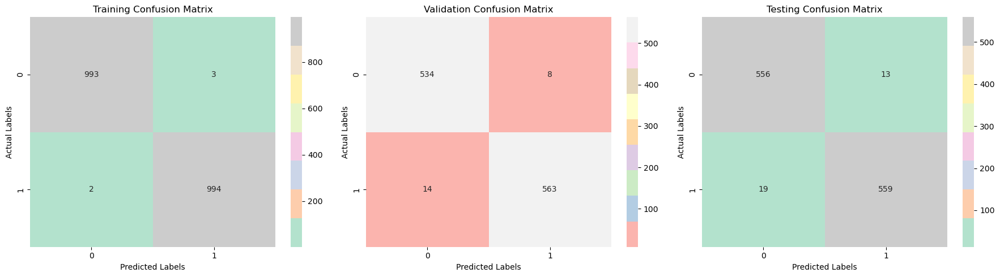

Training Set:
Accuracy: 0.9974899598393574
F1 Score: 0.997491219267436
Loss: 0.011312809772789478


Validation Set:
Accuracy: 0.9803395889186773
F1 Score: 0.980836236933798
Loss: 0.05450841039419174


Test Set:
Accuracy: 0.972101133391456
F1 Score: 0.9721739130434782
Loss: 0.10737581551074982




In [ ]:
Resnet_results_1sec=evaluate_model_video_level(model_resnet50_1sec,X_train_1sec,X_val_1sec,X_test_1sec,
                                        X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT,y_test_1secT)

# Print the results
for set_name, metrics in Resnet_results_1sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


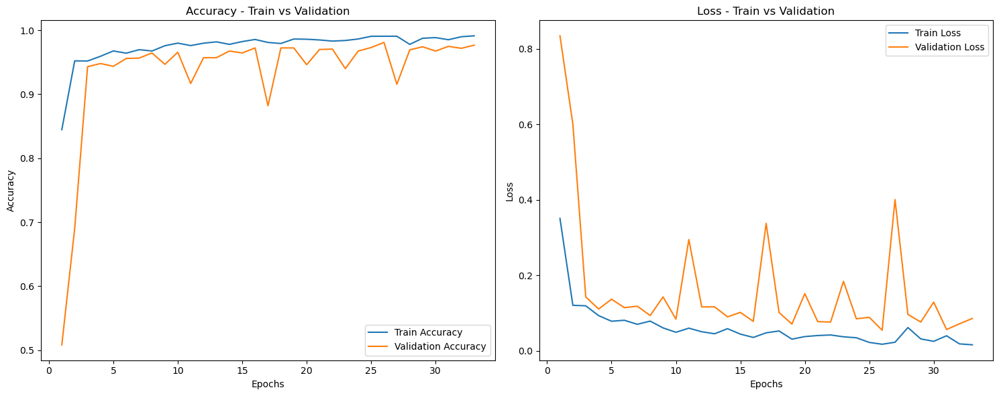

In [ ]:
# Plot the training history
plot_training_history(history_1sec)

### After 2 sec

In [ ]:
model_resnet50_2sec, history_2sec = ResnetModel_Model(X_train_2secT, y_train_2secT, X_val_2secT, y_val_2secT, X_test_2secT, y_test_2secT)

Epoch 1/100
200/200 [==============================] - 244s 1s/step - loss: 0.4952 - accuracy: 0.7676 - val_loss: 0.8010 - val_accuracy: 0.4856
Epoch 2/100
200/200 [==============================] - 219s 1s/step - loss: 0.1716 - accuracy: 0.9355 - val_loss: 1.8445 - val_accuracy: 0.4856
Epoch 3/100
200/200 [==============================] - 217s 1s/step - loss: 0.1118 - accuracy: 0.9509 - val_loss: 0.8056 - val_accuracy: 0.5257
Epoch 4/100
200/200 [==============================] - 219s 1s/step - loss: 0.0878 - accuracy: 0.9611 - val_loss: 1.0743 - val_accuracy: 0.5583
Epoch 5/100
200/200 [==============================] - 219s 1s/step - loss: 0.1419 - accuracy: 0.9430 - val_loss: 0.3593 - val_accuracy: 0.8407
Epoch 6/100
200/200 [==============================] - 219s 1s/step - loss: 0.1121 - accuracy: 0.9545 - val_loss: 0.2172 - val_accuracy: 0.9235
Epoch 7/100
200/200 [==============================] - 222s 1s/step - loss: 0.0836 - accuracy: 0.9655 - val_loss: 0.2663 - val_accuracy:

25/25 [==============================] - 9s 347ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
3,0,3,0,0,3,0
1886,1,2,0,0,2,0
1582,2,3,0,0,3,0
15,3,2,0,0,1,1
962,4,3,0,0,3,0
...,...,...,...,...,...,...
228,1995,4,1,1,0,4
1532,1996,5,1,1,0,5
96,1997,4,1,1,0,4
147,1998,9,1,0,7,2



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
569,6,1,0,0,1,0
459,8,1,0,0,1,0
315,11,1,0,0,1,0
513,12,1,0,1,0,1
175,14,1,0,0,1,0
...,...,...,...,...,...,...
266,1991,2,1,1,0,2
228,1993,1,1,1,0,1
195,1995,1,1,1,0,1
12,1998,2,1,0,2,0



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
375,10,1,0,0,1,0
542,12,1,0,0,1,0
79,20,2,0,0,2,0
505,22,1,0,0,1,0
303,26,1,0,0,1,0
...,...,...,...,...,...,...
456,1989,1,1,1,0,1
23,1992,2,1,1,0,2
230,1993,1,1,1,0,1
74,1997,1,1,1,0,1


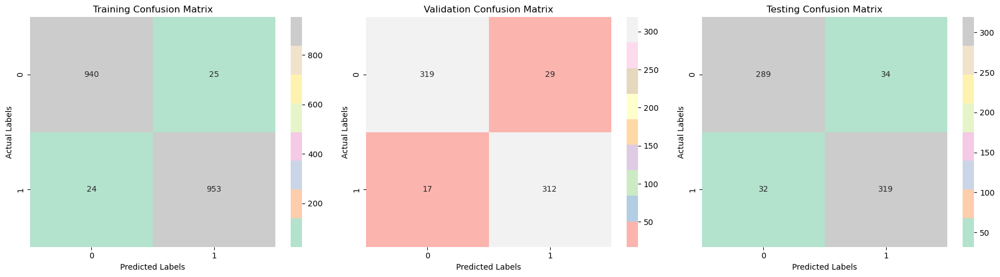

Training Set:
Accuracy: 0.974768280123584
F1 Score: 0.9749360613810741
Loss: 0.057650890201330185


Validation Set:
Accuracy: 0.9320531757754801
F1 Score: 0.9313432835820896
Loss: 0.21718807518482208


Test Set:
Accuracy: 0.9020771513353115
F1 Score: 0.9062499999999999
Loss: 0.2473526895046234




In [ ]:
Resnet_results_2sec=evaluate_model_video_level(model_resnet50_2sec,X_train_2sec,X_val_2sec,X_test_2sec,
                                        X_train_2secT, y_train_2secT, X_val_2secT, y_val_2secT, X_test_2secT,y_test_2secT)

# Print the results
for set_name, metrics in Resnet_results_2sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


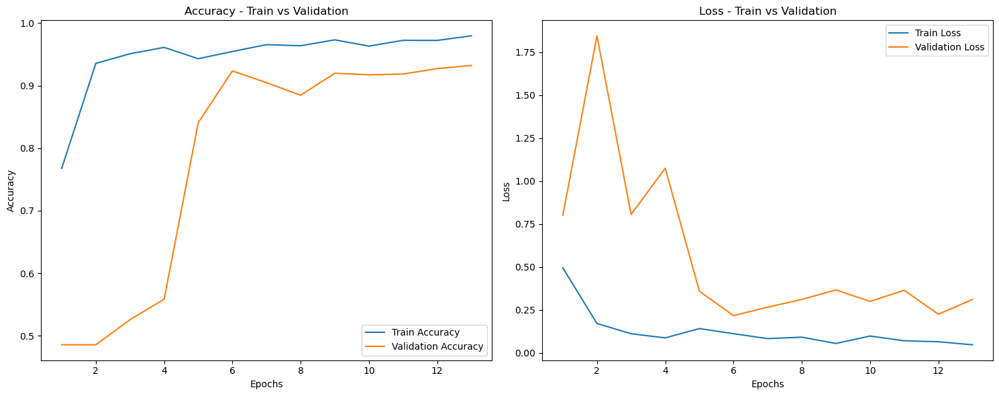

In [ ]:
plot_training_history(history_2sec)

### After 4 sec

In [ ]:
model_resnet50_4sec, history_4sec = ResnetModel_Model(X_train_4secT, y_train_4secT, X_val_4secT, y_val_4secT, X_test_4secT, y_test_4secT)

Epoch 1/100
82/82 [==============================] - 102s 1s/step - loss: 0.7078 - accuracy: 0.6224 - val_loss: 0.9889 - val_accuracy: 0.4908
Epoch 2/100
82/82 [==============================] - 87s 1s/step - loss: 0.2252 - accuracy: 0.9213 - val_loss: 1.4086 - val_accuracy: 0.4908
Epoch 3/100
82/82 [==============================] - 83s 1s/step - loss: 0.1165 - accuracy: 0.9620 - val_loss: 1.4367 - val_accuracy: 0.4908
Epoch 4/100
82/82 [==============================] - 80s 979ms/step - loss: 0.0941 - accuracy: 0.9674 - val_loss: 0.9953 - val_accuracy: 0.4908
Epoch 5/100
82/82 [==============================] - 81s 988ms/step - loss: 0.0635 - accuracy: 0.9724 - val_loss: 1.2135 - val_accuracy: 0.4816
Epoch 6/100
82/82 [==============================] - 86s 1s/step - loss: 0.0476 - accuracy: 0.9804 - val_loss: 1.2555 - val_accuracy: 0.4816
Epoch 7/100
82/82 [==============================] - 80s 979ms/step - loss: 0.0425 - accuracy: 0.9831 - val_loss: 1.1545 - val_accuracy: 0.5123
Epo

11/11 [==============================] - 3s 294ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1626,1,1,0,1,0,1
992,2,1,0,1,0,1
1305,3,1,0,1,0,1
1535,4,1,0,1,0,1
1308,5,1,0,1,0,1
...,...,...,...,...,...,...
1082,1995,1,1,1,0,1
65,1996,2,1,1,0,2
804,1997,2,1,1,0,2
803,1998,3,1,1,0,3



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
209,14,1,0,1,0,1
125,34,1,0,1,0,1
214,35,2,0,1,0,2
10,45,1,0,1,0,1
3,54,1,0,1,0,1
...,...,...,...,...,...,...
126,1946,1,1,1,0,1
253,1947,1,1,1,0,1
208,1948,1,1,1,0,1
176,1949,1,1,1,0,1



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
84,0,1,0,1,0,1
254,17,1,0,1,0,1
99,28,1,0,1,0,1
101,29,1,0,1,0,1
256,34,1,0,1,0,1
...,...,...,...,...,...,...
280,1984,1,1,1,0,1
107,1988,1,1,1,0,1
32,1995,1,1,1,0,1
59,1998,2,1,1,0,2


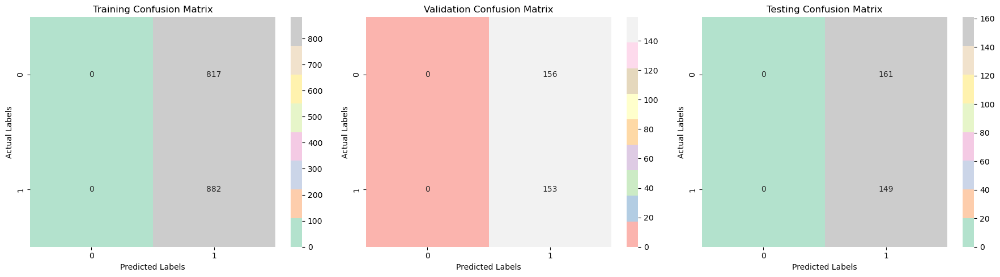

Training Set:
Accuracy: 0.5191288993525603
F1 Score: 0.6834560247965905
Loss: 0.9228131771087646


Validation Set:
Accuracy: 0.49514563106796117
F1 Score: 0.6623376623376623
Loss: 0.9888821244239807


Test Set:
Accuracy: 0.4806451612903226
F1 Score: 0.6492374727668845
Loss: 0.9946856498718262




In [ ]:
Resnet_results_4sec = evaluate_model_video_level(model_resnet50_4sec, X_train_4sec, X_val_4sec, X_test_4sec,
                                          X_train_4secT, y_train_4secT, X_val_4secT, y_val_4secT,X_test_4secT, y_test_4secT)

# Print the results
for set_name, metrics in Resnet_results_4sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


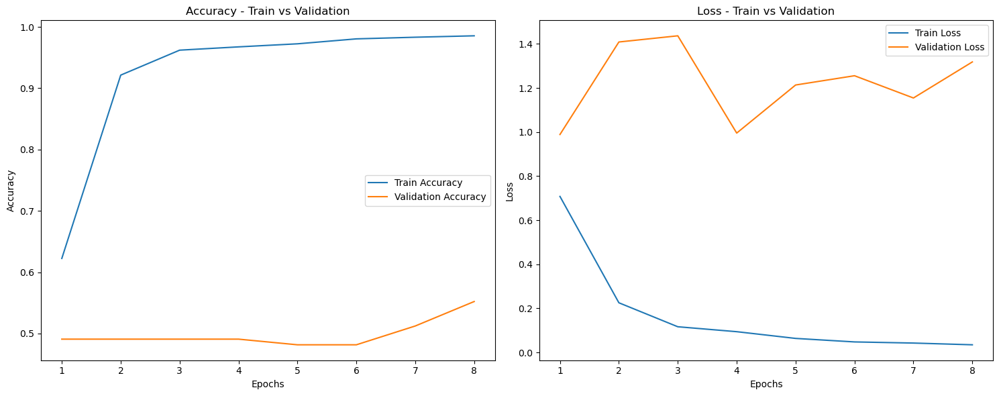

In [ ]:
plot_training_history(history_4sec)

## InceptionResNetV2 Model

`InceptionResNetV2_Model` aims to create an InceptionResNetV2-based neural network for binary classification tasks. It initializes a pre-trained InceptionResNetV2 model (excluding its top layer) pre-loaded with ImageNet weights. The function builds a Sequential model by adding the InceptionResNetV2 base model, a Global Average Pooling layer, and a Dense layer with a sigmoid activation function for binary classification. It sets up an Adam optimizer with a learning rate that exponentially decays, configures the model to optimize binary cross-entropy loss, and track accuracy metrics. It then trains the model using the provided training data (`X_train`, `y_train`) along with validation data (`X_val`, `y_val`) for a specific number of epochs and batch size, returning the trained model and its training history.

In [ ]:
def InceptionResNetV2_Model(X_train, y_train, X_val, y_val, X_test, y_test,epochs=100,batch_size=batch_size):
    # Model parameters
    input_shape = (128, 128, 3)
    epochs = epochs
    batch_size = batch_size
    initial_learning_rate = 0.0001

    # Create InceptionResNetV2 base model
    base_model = InceptionResNetV2(weights='imagenet', include_top=False, input_shape=input_shape)

    # Add custom head to the model
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.5)(x)  # Add dropout with a dropout rate of 0.5
    predictions = Dense(2, activation='softmax')(x)  # Use 2 neurons for binary classification

    model = Model(inputs=base_model.input, outputs=predictions)

    # Compile the model
    lr_schedule = ExponentialDecay(
        initial_learning_rate, decay_steps=100000, decay_rate=0.96, staircase=True
    )

    optimizer = Adam(learning_rate=lr_schedule)

    model.compile(
        loss='categorical_crossentropy',  # Use categorical_crossentropy for multiclass classification
        optimizer=optimizer,
        metrics=['accuracy']
    )

    # Define early stopping criteria
    early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)

    # Train the model with early stopping
    history = model.fit(
        X_train, y_train,
        validation_data=(X_val, y_val),
        epochs=epochs, batch_size=batch_size,
        callbacks=[early_stopping]
    )

    return model, history


### After 1 sec

In [ ]:
model_inceptionResNetV2_1sec, history_inceptionResNetV2_1sec = InceptionResNetV2_Model(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)


Epoch 1/100
410/410 [==============================] - 1026s 2s/step - loss: 0.5213 - accuracy: 0.7188 - val_loss: 0.2801 - val_accuracy: 0.8754
Epoch 2/100
410/410 [==============================] - 964s 2s/step - loss: 0.2202 - accuracy: 0.9053 - val_loss: 0.1995 - val_accuracy: 0.9243
Epoch 3/100
410/410 [==============================] - 957s 2s/step - loss: 0.1413 - accuracy: 0.9404 - val_loss: 0.1544 - val_accuracy: 0.9359
Epoch 4/100
410/410 [==============================] - 975s 2s/step - loss: 0.1066 - accuracy: 0.9561 - val_loss: 0.1898 - val_accuracy: 0.9395
Epoch 5/100
410/410 [==============================] - 980s 2s/step - loss: 0.1003 - accuracy: 0.9582 - val_loss: 0.2142 - val_accuracy: 0.9420
Epoch 6/100
410/410 [==============================] - 902s 2s/step - loss: 0.0846 - accuracy: 0.9633 - val_loss: 0.6927 - val_accuracy: 0.9432
Epoch 7/100
410/410 [==============================] - 527s 1s/step - loss: 0.0703 - accuracy: 0.9698 - val_loss: 0.3173 - val_accuracy

52/52 [==============================] - 15s 282ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1941,0,5,0,0,5,0
1420,1,4,0,0,4,0
1085,2,5,0,0,5,0
1715,3,3,0,0,3,0
1570,4,5,0,0,5,0
...,...,...,...,...,...,...
1347,1995,8,1,1,0,8
56,1996,8,1,1,0,8
878,1997,8,1,1,0,8
1555,1998,18,1,1,3,15



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
845,2,2,0,0,2,0
175,3,1,0,0,1,0
1109,8,1,0,0,1,0
580,11,1,0,0,1,0
562,12,1,0,0,1,0
...,...,...,...,...,...,...
854,1995,1,1,1,0,1
254,1996,1,1,1,0,1
118,1997,2,1,1,0,2
860,1998,1,1,0,1,0



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
702,0,2,0,0,2,0
148,1,1,0,0,1,0
1061,4,1,0,0,1,0
591,5,2,0,0,2,0
333,6,1,0,0,1,0
...,...,...,...,...,...,...
134,1994,2,1,1,0,2
845,1995,1,1,1,0,1
209,1996,1,1,1,0,1
131,1998,3,1,0,2,1


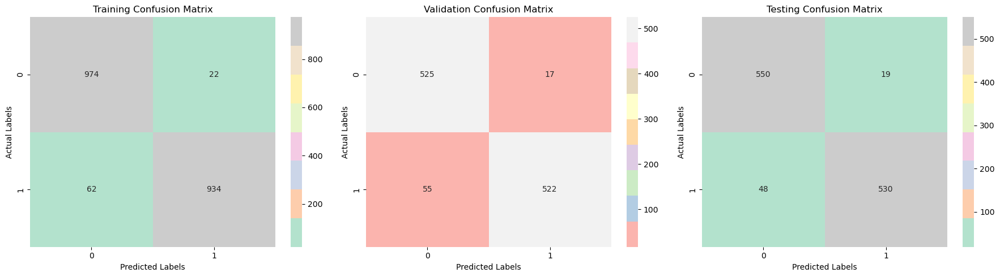

Training Set:
Accuracy: 0.9578313253012049
F1 Score: 0.9569672131147541
Loss: 0.09749304503202438


Validation Set:
Accuracy: 0.935656836461126
F1 Score: 0.9354838709677419
Loss: 0.15444335341453552


Test Set:
Accuracy: 0.941586748038361
F1 Score: 0.940550133096717
Loss: 0.1745855063199997




In [ ]:
inceptionResNetV2_results_1sec=evaluate_model_video_level(model_inceptionResNetV2_1sec, X_train_1sec, X_val_1sec, X_test_1sec,
                                        X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT,X_test_1secT, y_test_1secT)

# Print the results
for set_name, metrics in inceptionResNetV2_results_1sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


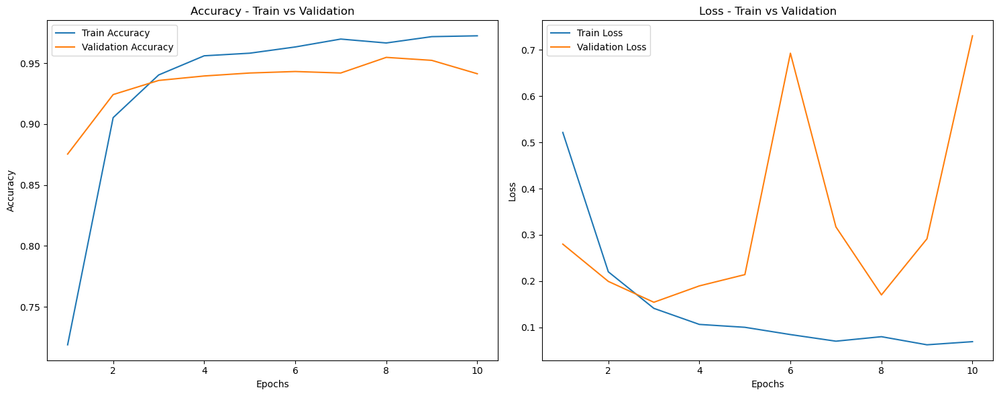

In [ ]:
plot_training_history(history_inceptionResNetV2_1sec)

### After 2 sec

In [ ]:
model_inceptionResNetV2_2sec,history_inceptionResNetV2_2sec = InceptionResNetV2_Model(X_train_2secT, y_train_2secT, X_val_2secT, y_val_2secT, X_test_2secT, y_test_2secT)

Epoch 1/100
200/200 [==============================] - 282s 1s/step - loss: 0.6881 - accuracy: 0.5890 - val_loss: 0.5975 - val_accuracy: 0.6838
Epoch 2/100
200/200 [==============================] - 249s 1s/step - loss: 0.4504 - accuracy: 0.7965 - val_loss: 0.4419 - val_accuracy: 0.8218
Epoch 3/100
200/200 [==============================] - 249s 1s/step - loss: 0.2276 - accuracy: 0.9054 - val_loss: 0.2975 - val_accuracy: 0.8808
Epoch 4/100
200/200 [==============================] - 249s 1s/step - loss: 0.1343 - accuracy: 0.9379 - val_loss: 0.3849 - val_accuracy: 0.8946
Epoch 5/100
200/200 [==============================] - 249s 1s/step - loss: 0.1485 - accuracy: 0.9344 - val_loss: 0.3055 - val_accuracy: 0.9034
Epoch 6/100
200/200 [==============================] - 249s 1s/step - loss: 0.1120 - accuracy: 0.9485 - val_loss: 0.3508 - val_accuracy: 0.9059
Epoch 7/100
200/200 [==============================] - 254s 1s/step - loss: 0.0968 - accuracy: 0.9559 - val_loss: 0.2939 - val_accuracy:

25/25 [==============================] - 7s 275ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
3,0,3,0,0,3,0
1886,1,2,0,0,2,0
1582,2,3,0,0,3,0
15,3,2,0,0,2,0
962,4,3,0,0,3,0
...,...,...,...,...,...,...
228,1995,4,1,1,0,4
1532,1996,5,1,1,0,5
96,1997,4,1,1,0,4
147,1998,9,1,0,6,3



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
569,6,1,0,0,1,0
459,8,1,0,0,1,0
315,11,1,0,0,1,0
513,12,1,0,0,1,0
175,14,1,0,0,1,0
...,...,...,...,...,...,...
266,1991,2,1,1,0,2
228,1993,1,1,1,0,1
195,1995,1,1,1,0,1
12,1998,2,1,0,2,0



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
375,10,1,0,0,1,0
542,12,1,0,0,1,0
79,20,2,0,0,2,0
505,22,1,0,0,1,0
303,26,1,0,0,1,0
...,...,...,...,...,...,...
456,1989,1,1,1,0,1
23,1992,2,1,1,0,2
230,1993,1,1,1,0,1
74,1997,1,1,1,0,1


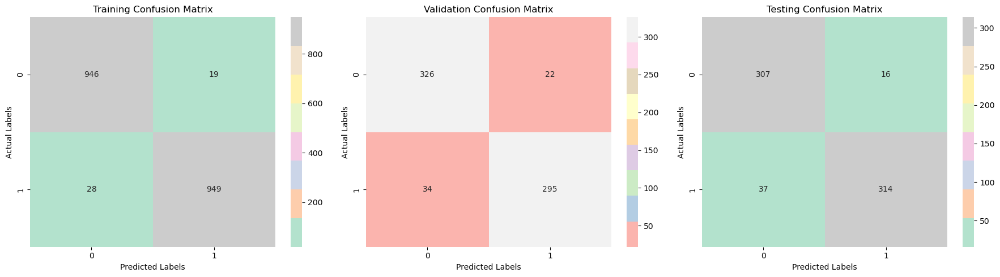

Training Set:
Accuracy: 0.9757981462409887
F1 Score: 0.9758354755784062
Loss: 0.11082714051008224


Validation Set:
Accuracy: 0.9172821270310192
F1 Score: 0.913312693498452
Loss: 0.2939348816871643


Test Set:
Accuracy: 0.9213649851632048
F1 Score: 0.9221732745961821
Loss: 0.2838016152381897




In [ ]:
inceptionResNetV2_results_2sec = evaluate_model_video_level(model_inceptionResNetV2_2sec, X_train_2sec, X_val_2sec, X_test_2sec,
                                          X_train_2secT, y_train_2secT, X_val_2secT, y_val_2secT,
                                          X_test_2secT, y_test_2secT)

# Print the results for 2-second video data
for set_name, metrics in inceptionResNetV2_results_2sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


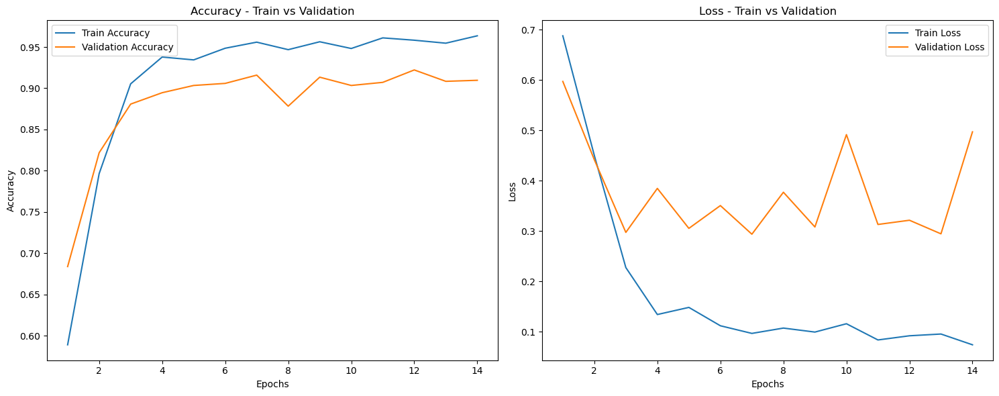

In [ ]:
plot_training_history(history_inceptionResNetV2_2sec)

### After 4 sec

In [ ]:
model_inceptionResNetV2_4sec,history_inceptionResNetV2_4sec = InceptionResNetV2_Model(X_train_4secT, y_train_4secT, X_val_4secT, y_val_4secT, X_test_4secT, y_test_4secT)

Epoch 1/100
82/82 [==============================] - 141s 1s/step - loss: 0.7374 - accuracy: 0.5368 - val_loss: 0.6987 - val_accuracy: 0.5736
Epoch 2/100
82/82 [==============================] - 108s 1s/step - loss: 0.5754 - accuracy: 0.7007 - val_loss: 0.6294 - val_accuracy: 0.6810
Epoch 3/100
82/82 [==============================] - 104s 1s/step - loss: 0.3718 - accuracy: 0.8365 - val_loss: 0.6011 - val_accuracy: 0.7178
Epoch 4/100
82/82 [==============================] - 106s 1s/step - loss: 0.2323 - accuracy: 0.9037 - val_loss: 0.6147 - val_accuracy: 0.7577
Epoch 5/100
82/82 [==============================] - 105s 1s/step - loss: 0.1882 - accuracy: 0.9217 - val_loss: 0.6431 - val_accuracy: 0.7638
Epoch 6/100
82/82 [==============================] - 105s 1s/step - loss: 0.1328 - accuracy: 0.9470 - val_loss: 0.6526 - val_accuracy: 0.7914
Epoch 7/100
82/82 [==============================] - 105s 1s/step - loss: 0.1244 - accuracy: 0.9501 - val_loss: 0.7812 - val_accuracy: 0.7791
Epoch 

11/11 [==============================] - 3s 255ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1626,1,1,0,0,1,0
992,2,1,0,0,1,0
1305,3,1,0,1,0,1
1535,4,1,0,0,1,0
1308,5,1,0,0,1,0
...,...,...,...,...,...,...
1082,1995,1,1,1,0,1
65,1996,2,1,1,0,2
804,1997,2,1,1,0,2
803,1998,3,1,1,0,3



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
209,14,1,0,1,0,1
125,34,1,0,1,0,1
214,35,2,0,0,2,0
10,45,1,0,1,0,1
3,54,1,0,1,0,1
...,...,...,...,...,...,...
126,1946,1,1,1,0,1
253,1947,1,1,1,0,1
208,1948,1,1,0,1,0
176,1949,1,1,1,0,1



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
84,0,1,0,0,1,0
254,17,1,0,1,0,1
99,28,1,0,1,0,1
101,29,1,0,0,1,0
256,34,1,0,0,1,0
...,...,...,...,...,...,...
280,1984,1,1,1,0,1
107,1988,1,1,1,0,1
32,1995,1,1,1,0,1
59,1998,2,1,0,1,1


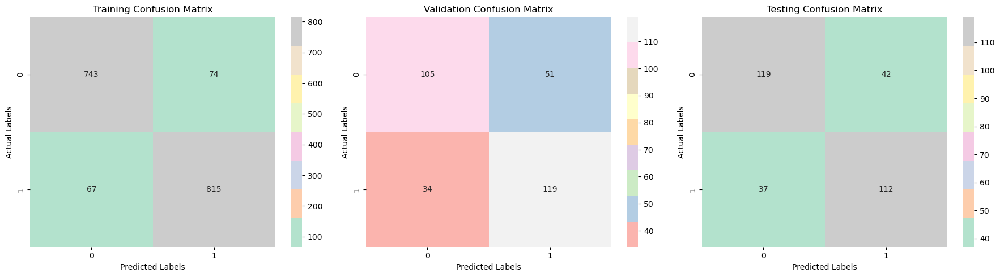

Training Set:
Accuracy: 0.9170100058858152
F1 Score: 0.9203839638622248
Loss: 0.20991545915603638


Validation Set:
Accuracy: 0.7249190938511327
F1 Score: 0.7368421052631577
Loss: 0.6010577082633972


Test Set:
Accuracy: 0.7451612903225806
F1 Score: 0.7392739273927393
Loss: 0.5253698229789734




In [ ]:
inceptionResNetV2_results_4sec = evaluate_model_video_level(model_inceptionResNetV2_4sec, X_train_4sec, X_val_4sec, X_test_4sec,
                                          X_train_4secT, y_train_4secT, X_val_4secT, y_val_4secT,
                                          X_test_4secT, y_test_4secT)

# Print the results for 4-second video data
for set_name, metrics in inceptionResNetV2_results_4sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


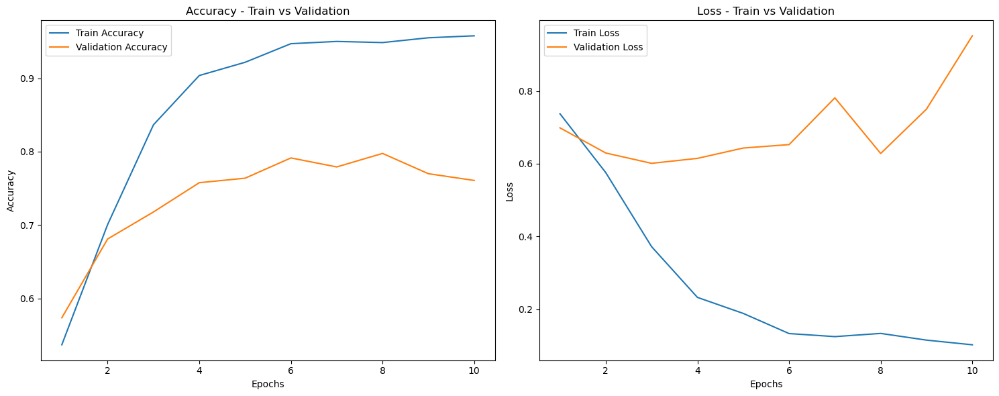

In [ ]:
plot_training_history(history_inceptionResNetV2_4sec)

## MobileNetV2 Model

`MobileNetV2_Model` function is designed to create a custom classifier using the MobileNetV2 architecture pre-trained on ImageNet. It imports the MobileNetV2 model excluding its top layer, adds custom layers for classification: a Global Average Pooling layer, a Dense layer with 128 units and ReLU activation, and a Dense layer for 2-class classification using softmax activation. The function constructs a new model by combining the base MobileNetV2 layers with the custom classification layers. It configures the model to use an Adam optimizer with a specified learning rate, optimizing categorical cross-entropy loss, and tracking accuracy metrics. Finally, it trains the model on provided training data (`X_train`, `y_train`) and validation data (`X_val`, `y_val`) for a defined number of epochs and batch size, returning the trained model and its training history.

In [ ]:
def MobileNetV2_Model(X_train, y_train, X_val, y_val, X_test, y_test, epochs=epochs, batch_size=batch_size):
    # Load the MobileNetV2 model pre-trained on ImageNet
    base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

    # Add custom classification layers on top of MobileNetV2
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)  # Add dropout with a dropout rate of 0.5
    predictions = Dense(2, activation='softmax')(x)

    # Create a new model combining MobileNetV2 base and custom layers
    model = Model(inputs=base_model.input, outputs=predictions)
    custom_optimizer = Adam(learning_rate=0.0001)  # Set your desired learning rate here

    # Compile the model
    model.compile(optimizer=custom_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    # Define early stopping criteria
    early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)

    # Train the model with early stopping
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping])

    return model, history


### After 1 sec

In [ ]:
model_MobileNetV2_1sec,history_MobileNetV2_1sec = MobileNetV2_Model(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)

Epoch 1/100
410/410 [==============================] - 135s 308ms/step - loss: 0.5689 - accuracy: 0.7091 - val_loss: 0.6242 - val_accuracy: 0.6878
Epoch 2/100
410/410 [==============================] - 122s 296ms/step - loss: 0.2471 - accuracy: 0.9038 - val_loss: 0.4551 - val_accuracy: 0.7856
Epoch 3/100
410/410 [==============================] - 121s 295ms/step - loss: 0.1378 - accuracy: 0.9472 - val_loss: 0.5685 - val_accuracy: 0.7844
Epoch 4/100
410/410 [==============================] - 121s 295ms/step - loss: 0.1023 - accuracy: 0.9592 - val_loss: 0.8952 - val_accuracy: 0.7550
Epoch 5/100
410/410 [==============================] - 121s 296ms/step - loss: 0.0892 - accuracy: 0.9617 - val_loss: 0.3678 - val_accuracy: 0.8650
Epoch 6/100
410/410 [==============================] - 121s 296ms/step - loss: 0.0886 - accuracy: 0.9672 - val_loss: 0.2631 - val_accuracy: 0.8962
Epoch 7/100
410/410 [==============================] - 121s 295ms/step - loss: 0.0627 - accuracy: 0.9750 - val_loss: 0

52/52 [==============================] - 4s 70ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1941,0,5,0,0,5,0
1420,1,4,0,0,4,0
1085,2,5,0,0,5,0
1715,3,3,0,0,3,0
1570,4,5,0,0,5,0
...,...,...,...,...,...,...
1347,1995,8,1,1,0,8
56,1996,8,1,1,0,8
878,1997,8,1,1,0,8
1555,1998,18,1,1,1,17



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
845,2,2,0,0,2,0
175,3,1,0,0,1,0
1109,8,1,0,0,1,0
580,11,1,0,0,1,0
562,12,1,0,0,1,0
...,...,...,...,...,...,...
854,1995,1,1,1,0,1
254,1996,1,1,1,0,1
118,1997,2,1,1,0,2
860,1998,1,1,1,0,1



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
702,0,2,0,0,2,0
148,1,1,0,0,1,0
1061,4,1,0,0,1,0
591,5,2,0,0,2,0
333,6,1,0,0,1,0
...,...,...,...,...,...,...
134,1994,2,1,1,0,2
845,1995,1,1,1,0,1
209,1996,1,1,1,0,1
131,1998,3,1,1,0,3


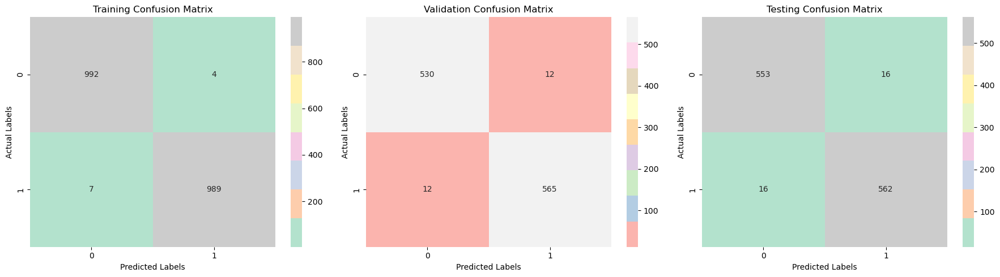

Training Set:
Accuracy: 0.9944779116465864
F1 Score: 0.9944695827048768
Loss: 0.013075600378215313


Validation Set:
Accuracy: 0.9785522788203753
F1 Score: 0.9792027729636048
Loss: 0.06014421209692955


Test Set:
Accuracy: 0.972101133391456
F1 Score: 0.972318339100346
Loss: 0.1489078849554062




In [ ]:
MobileNetV2_results_1sec=evaluate_model_video_level(model_MobileNetV2_1sec,X_train_1sec,X_val_1sec,X_test_1sec,
                                        X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT,y_test_1secT)

# Print the results
for set_name, metrics in MobileNetV2_results_1sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


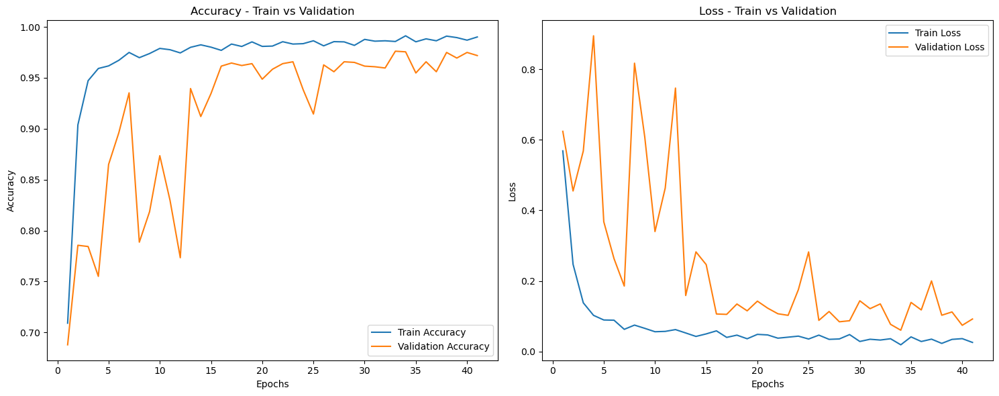

In [ ]:
plot_training_history(history_MobileNetV2_1sec)

In [ ]:
# Step 2: Save the model and history using pickle
with open('MobileNetV2_model_history.pkl', 'wb') as file:
    # Save the model and history in a dictionary
    model_history_dict_MobileNetV2 = {'model': model_MobileNetV2_1sec, 'history': history_MobileNetV2_1sec.history}

    # Use pickle to dump the dictionary into the file
    pickle.dump(model_history_dict_MobileNetV2, file)


In [ ]:
# Load the saved file and inspect its contents
with open('MobileNetV2_model_history.pkl', 'rb') as file:
    loaded_model_history_dict_MobileNetV2 = pickle.load(file)

# Extract the model and history from the loaded dictionary
loaded_model_MobileNetV2 = loaded_model_history_dict_MobileNetV2['model']
loaded_history_MobileNetV2 = loaded_model_history_dict_MobileNetV2['history']

# Now you can use or inspect the loaded model and history
print("Loaded Model Summary:")
print(loaded_model_MobileNetV2.summary())

# Print or inspect the loaded history
print("Loaded History:")
print(loaded_history_MobileNetV2)


Loaded Model Summary:
Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 64, 64, 32)           864       ['input_7[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 64, 64, 32)           128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 64, 64, 32)           0         ['

### After 2 sec

In [ ]:
model_MobileNetV2_2sec,history_MobileNetV2_2sec = MobileNetV2_Model(X_train_2secT, y_train_2secT, X_val_2secT, y_val_2secT, X_test_2secT, y_test_2secT)

Epoch 1/100
200/200 [==============================] - 67s 290ms/step - loss: 0.7028 - accuracy: 0.6257 - val_loss: 0.6734 - val_accuracy: 0.6110
Epoch 2/100
200/200 [==============================] - 60s 299ms/step - loss: 0.4175 - accuracy: 0.8120 - val_loss: 0.6086 - val_accuracy: 0.6725
Epoch 3/100
200/200 [==============================] - 58s 290ms/step - loss: 0.2624 - accuracy: 0.8974 - val_loss: 0.5375 - val_accuracy: 0.7528
Epoch 4/100
200/200 [==============================] - 59s 297ms/step - loss: 0.1827 - accuracy: 0.9295 - val_loss: 0.5308 - val_accuracy: 0.7616
Epoch 5/100
200/200 [==============================] - 60s 299ms/step - loss: 0.1345 - accuracy: 0.9501 - val_loss: 0.3973 - val_accuracy: 0.8168
Epoch 6/100
200/200 [==============================] - 59s 294ms/step - loss: 0.1098 - accuracy: 0.9592 - val_loss: 0.5047 - val_accuracy: 0.7930
Epoch 7/100
200/200 [==============================] - 59s 297ms/step - loss: 0.1034 - accuracy: 0.9628 - val_loss: 0.5607 -

25/25 [==============================] - 2s 72ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
3,0,3,0,0,3,0
1886,1,2,0,0,2,0
1582,2,3,0,0,3,0
15,3,2,0,0,2,0
962,4,3,0,0,3,0
...,...,...,...,...,...,...
228,1995,4,1,1,0,4
1532,1996,5,1,1,0,5
96,1997,4,1,1,0,4
147,1998,9,1,1,0,9



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
569,6,1,0,0,1,0
459,8,1,0,0,1,0
315,11,1,0,0,1,0
513,12,1,0,0,1,0
175,14,1,0,0,1,0
...,...,...,...,...,...,...
266,1991,2,1,1,0,2
228,1993,1,1,1,0,1
195,1995,1,1,1,0,1
12,1998,2,1,0,1,1



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
375,10,1,0,0,1,0
542,12,1,0,0,1,0
79,20,2,0,0,2,0
505,22,1,0,0,1,0
303,26,1,0,0,1,0
...,...,...,...,...,...,...
456,1989,1,1,0,1,0
23,1992,2,1,1,0,2
230,1993,1,1,1,0,1
74,1997,1,1,1,0,1


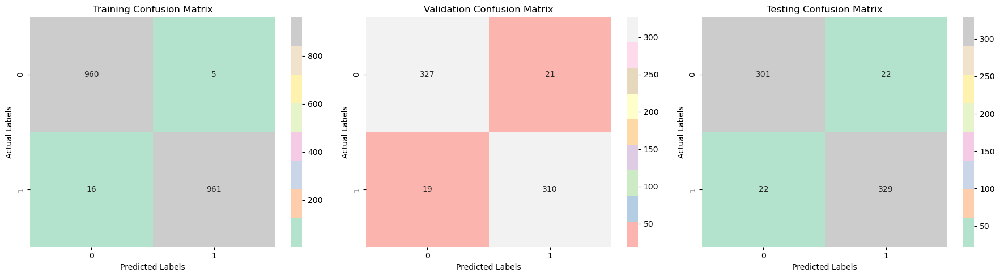

Training Set:
Accuracy: 0.9891864057672503
F1 Score: 0.9891919711785897
Loss: 0.03657013550400734


Validation Set:
Accuracy: 0.9409158050221565
F1 Score: 0.9393939393939393
Loss: 0.1915876269340515


Test Set:
Accuracy: 0.9347181008902077
F1 Score: 0.9373219373219374
Loss: 0.2096230387687683




In [ ]:
MobileNetV2_results_2sec = evaluate_model_video_level(model_MobileNetV2_2sec, X_train_2sec, X_val_2sec, X_test_2sec,
                                          X_train_2secT, y_train_2secT, X_val_2secT, y_val_2secT,X_test_2secT, y_test_2secT)

# Print the results
for set_name, metrics in MobileNetV2_results_2sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")

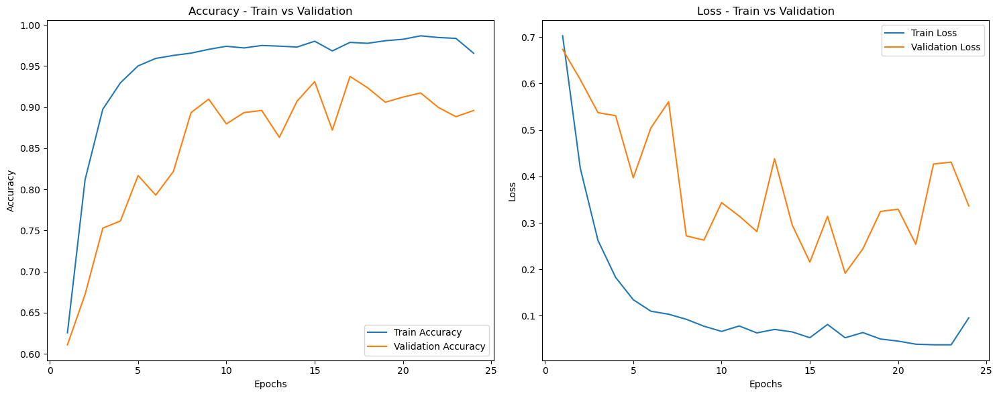

In [ ]:
plot_training_history(history_MobileNetV2_2sec)

### After 4 sec

In [ ]:
model_MobileNetV2_4sec,history_MobileNetV2_4sec = MobileNetV2_Model(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)

Epoch 1/100
410/410 [==============================] - 131s 299ms/step - loss: 0.5526 - accuracy: 0.7210 - val_loss: 0.5912 - val_accuracy: 0.6836
Epoch 2/100
410/410 [==============================] - 122s 298ms/step - loss: 0.2460 - accuracy: 0.9042 - val_loss: 0.5022 - val_accuracy: 0.7807
Epoch 3/100
410/410 [==============================] - 122s 298ms/step - loss: 0.1425 - accuracy: 0.9482 - val_loss: 0.2561 - val_accuracy: 0.8962
Epoch 4/100
410/410 [==============================] - 122s 298ms/step - loss: 0.0982 - accuracy: 0.9620 - val_loss: 0.2716 - val_accuracy: 0.8943
Epoch 5/100
410/410 [==============================] - 122s 298ms/step - loss: 0.0902 - accuracy: 0.9644 - val_loss: 0.2259 - val_accuracy: 0.9096
Epoch 6/100
410/410 [==============================] - 122s 299ms/step - loss: 0.0822 - accuracy: 0.9660 - val_loss: 0.1692 - val_accuracy: 0.9389
Epoch 7/100
410/410 [==============================] - 122s 298ms/step - loss: 0.0663 - accuracy: 0.9737 - val_loss: 0

11/11 [==============================] - 1s 62ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1626,1,1,0,0,1,0
992,2,1,0,0,1,0
1305,3,1,0,0,1,0
1535,4,1,0,0,1,0
1308,5,1,0,0,1,0
...,...,...,...,...,...,...
1082,1995,1,1,1,0,1
65,1996,2,1,1,0,2
804,1997,2,1,1,0,2
803,1998,3,1,0,1,2



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
209,14,1,0,0,1,0
125,34,1,0,0,1,0
214,35,2,0,0,2,0
10,45,1,0,0,1,0
3,54,1,0,0,1,0
...,...,...,...,...,...,...
126,1946,1,1,1,0,1
253,1947,1,1,1,0,1
208,1948,1,1,1,0,1
176,1949,1,1,1,0,1



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
84,0,1,0,0,1,0
254,17,1,0,0,1,0
99,28,1,0,0,1,0
101,29,1,0,0,1,0
256,34,1,0,0,1,0
...,...,...,...,...,...,...
280,1984,1,1,1,0,1
107,1988,1,1,1,0,1
32,1995,1,1,1,0,1
59,1998,2,1,1,0,2


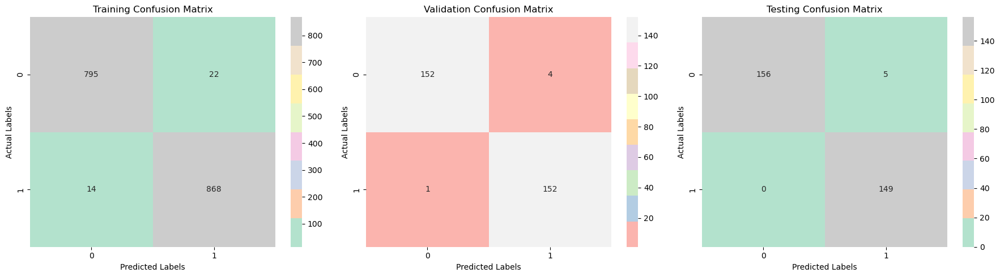

Training Set:
Accuracy: 0.9788110653325486
F1 Score: 0.9796839729119639
Loss: 0.062099505215883255


Validation Set:
Accuracy: 0.9838187702265372
F1 Score: 0.9838187702265372
Loss: 0.03210107982158661


Test Set:
Accuracy: 0.9838709677419355
F1 Score: 0.9834983498349835
Loss: 0.04401339963078499




In [ ]:
MobileNetV2_results_4sec = evaluate_model_video_level(model_MobileNetV2_4sec, X_train_4sec, X_val_4sec, X_test_4sec,
                                          X_train_4secT, y_train_4secT, X_val_4secT, y_val_4secT,X_test_4secT, y_test_4secT)

# Print the results
for set_name, metrics in MobileNetV2_results_4sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


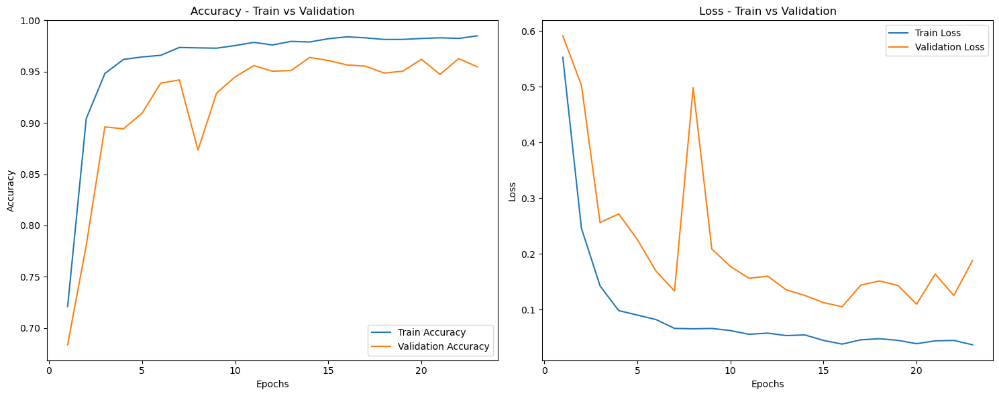

In [ ]:
plot_training_history(history_MobileNetV2_4sec)

## VGG 16

`vgg_transfer_model` function utilizes the VGG16 model pre-trained on ImageNet and creates a new model by appending custom classification layers at the top. It extracts the output of the last layer from the VGG16 architecture and adds a Flatten layer, a Dense layer with 256 units and ReLU activation, followed by a Dense layer for 2-class classification using softmax activation. The function constructs a new model (`vgg_model_transfer`) by linking the VGG16 base layers with the custom classification layers and then freezes the layers of the VGG16 model to retain their pre-trained weights. The model is compiled with stochastic gradient descent (SGD) optimizer configured with a low learning rate and categorical cross-entropy loss. Finally, it trains the model using provided training data (`X_train`, `y_train`) for a specified number of epochs and batch size while validating on validation data (`X_val`, `y_val`), returning the trained model and its training history.

In [ ]:
def vgg_transfer_model(X_train, y_train, X_val, y_val, X_test, y_test, epochs=epochs, batch_size=batch_size):
    # Load the VGG16 model pre-trained on ImageNet
    vgg_model = VGG16(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

    # Add custom classification layers on top of VGG16
    x = vgg_model.layers[-1].output  # Access the last layer's output of VGG16
    x = Flatten()(x)  # Flatten the output tensor
    x = Dense(256, activation='relu')(x)  # Add a Dense layer with ReLU activation
    x = Dropout(0.5)(x)  # Add dropout with a dropout rate of 0.5
    x = Dense(2, activation='softmax')(x)  # Add the output layer with softmax activation for classification

    vgg_model_transfer = Model(inputs=vgg_model.input, outputs=x)  # Create a new model with modified top layers

    # Freeze layers in the pre-trained VGG16 model
    for layer in vgg_model_transfer.layers:
        layer.trainable = False  # Set layers as non-trainable

    sgd = SGD(lr=0.0001)  # Stochastic Gradient Descent optimizer with a specific learning rate
    vgg_model_transfer.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])  # Compile the model

    # Define early stopping criteria
    early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)

    # Train the model with early stopping
    history = vgg_model_transfer.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=1,
                                     validation_data=(X_val, y_val), callbacks=[early_stopping])

    return vgg_model_transfer, history


### After 1 sec

In [ ]:
model_VGG16_1sec,history_VGG16_1sec = vgg_transfer_model(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)

Epoch 1/100
410/410 [==============================] - 268s 652ms/step - loss: 0.8465 - accuracy: 0.4972 - val_loss: 0.7188 - val_accuracy: 0.5125
Epoch 2/100
410/410 [==============================] - 267s 651ms/step - loss: 0.8546 - accuracy: 0.4882 - val_loss: 0.7188 - val_accuracy: 0.5125
Epoch 3/100
410/410 [==============================] - 267s 651ms/step - loss: 0.8579 - accuracy: 0.4898 - val_loss: 0.7188 - val_accuracy: 0.5125
Epoch 4/100
410/410 [==============================] - 270s 660ms/step - loss: 0.8471 - accuracy: 0.4956 - val_loss: 0.7188 - val_accuracy: 0.5125
Epoch 5/100
410/410 [==============================] - 275s 672ms/step - loss: 0.8607 - accuracy: 0.4850 - val_loss: 0.7188 - val_accuracy: 0.5125
Epoch 6/100
410/410 [==============================] - 275s 672ms/step - loss: 0.8486 - accuracy: 0.4918 - val_loss: 0.7188 - val_accuracy: 0.5125
Epoch 7/100
410/410 [==============================] - 282s 688ms/step - loss: 0.8448 - accuracy: 0.4998 - val_loss: 0

52/52 [==============================] - 31s 589ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1941,0,5,0,1,0,5
1420,1,4,0,0,4,0
1085,2,5,0,0,5,0
1715,3,3,0,0,3,0
1570,4,5,0,1,0,5
...,...,...,...,...,...,...
1347,1995,8,1,0,8,0
56,1996,8,1,1,0,8
878,1997,8,1,0,7,1
1555,1998,18,1,0,6,12



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
845,2,2,0,0,2,0
175,3,1,0,0,1,0
1109,8,1,0,0,1,0
580,11,1,0,0,1,0
562,12,1,0,0,1,0
...,...,...,...,...,...,...
854,1995,1,1,0,1,0
254,1996,1,1,1,0,1
118,1997,2,1,0,2,0
860,1998,1,1,1,0,1



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
702,0,2,0,1,0,2
148,1,1,0,0,1,0
1061,4,1,0,1,0,1
591,5,2,0,0,1,1
333,6,1,0,0,1,0
...,...,...,...,...,...,...
134,1994,2,1,0,2,0
845,1995,1,1,0,1,0
209,1996,1,1,1,0,1
131,1998,3,1,1,0,3


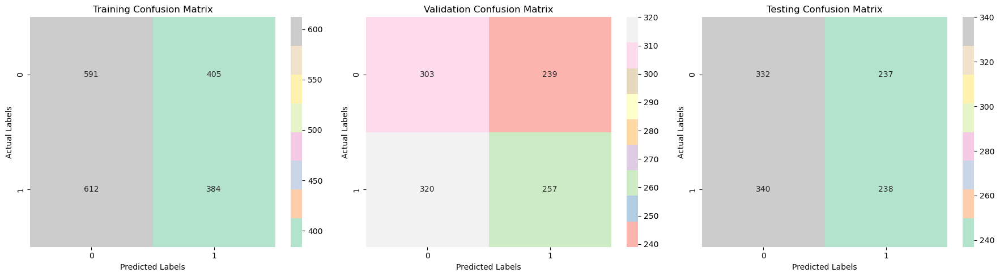

Training Set:
Accuracy: 0.4894578313253012
F1 Score: 0.4302521008403361
Loss: 0.7322094440460205


Validation Set:
Accuracy: 0.5004468275245755
F1 Score: 0.47903075489282393
Loss: 0.7188405990600586


Test Set:
Accuracy: 0.4969485614646905
F1 Score: 0.45204178537511874
Loss: 0.7265628576278687




In [ ]:
VGG16_results_1sec=evaluate_model_video_level(model_VGG16_1sec,X_train_1sec,X_val_1sec,X_test_1sec,
                                        X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT,y_test_1secT)

# Print the results
for set_name, metrics in VGG16_results_1sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


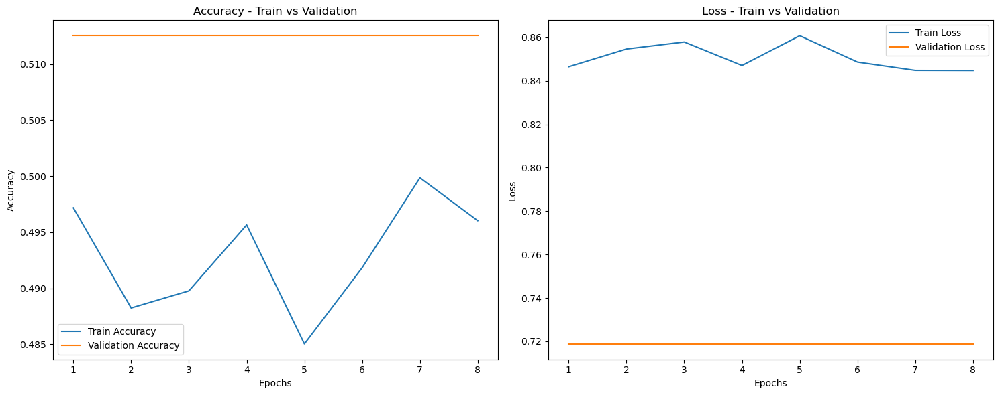

In [ ]:
plot_training_history(history_VGG16_1sec)

### After 2 sec

In [ ]:
model_VGG16_2sec,history_VGG16_2sec = vgg_transfer_model(X_train_2secT, y_train_2secT, X_val_2secT, y_val_2secT, X_test_2secT, y_test_2secT)

Epoch 1/100
200/200 [==============================] - 135s 672ms/step - loss: 0.8654 - accuracy: 0.4995 - val_loss: 0.7301 - val_accuracy: 0.4893
Epoch 2/100
200/200 [==============================] - 133s 666ms/step - loss: 0.8717 - accuracy: 0.4983 - val_loss: 0.7301 - val_accuracy: 0.4893
Epoch 3/100
200/200 [==============================] - 133s 666ms/step - loss: 0.8784 - accuracy: 0.4991 - val_loss: 0.7301 - val_accuracy: 0.4893
Epoch 4/100
200/200 [==============================] - 133s 665ms/step - loss: 0.8709 - accuracy: 0.5038 - val_loss: 0.7301 - val_accuracy: 0.4893
Epoch 5/100
200/200 [==============================] - 133s 666ms/step - loss: 0.8721 - accuracy: 0.4981 - val_loss: 0.7301 - val_accuracy: 0.4893
Epoch 6/100
200/200 [==============================] - 133s 666ms/step - loss: 0.8539 - accuracy: 0.5025 - val_loss: 0.7301 - val_accuracy: 0.4893
Epoch 7/100
200/200 [==============================] - 133s 664ms/step - loss: 0.8716 - accuracy: 0.4986 - val_loss: 0

25/25 [==============================] - 15s 588ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
3,0,3,0,1,0,3
1886,1,2,0,0,2,0
1582,2,3,0,1,0,3
15,3,2,0,1,0,2
962,4,3,0,1,0,3
...,...,...,...,...,...,...
228,1995,4,1,1,0,4
1532,1996,5,1,1,0,5
96,1997,4,1,1,1,3
147,1998,9,1,1,1,8



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
569,6,1,0,1,0,1
459,8,1,0,1,0,1
315,11,1,0,1,0,1
513,12,1,0,1,0,1
175,14,1,0,1,0,1
...,...,...,...,...,...,...
266,1991,2,1,1,0,2
228,1993,1,1,1,0,1
195,1995,1,1,1,0,1
12,1998,2,1,1,0,2



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
375,10,1,0,1,0,1
542,12,1,0,1,0,1
79,20,2,0,1,0,2
505,22,1,0,1,0,1
303,26,1,0,0,1,0
...,...,...,...,...,...,...
456,1989,1,1,1,0,1
23,1992,2,1,1,0,2
230,1993,1,1,1,0,1
74,1997,1,1,1,0,1


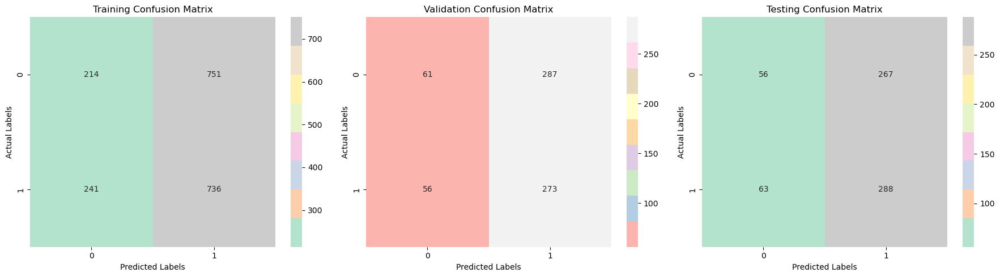

Training Set:
Accuracy: 0.48918640576725025
F1 Score: 0.5974025974025975
Loss: 0.7305349707603455


Validation Set:
Accuracy: 0.4933530280649926
F1 Score: 0.6141732283464566
Loss: 0.7300823330879211


Test Set:
Accuracy: 0.5103857566765578
F1 Score: 0.6357615894039735
Loss: 0.7305129766464233




In [ ]:
VGG16_results_2sec = evaluate_model_video_level(model_VGG16_2sec, X_train_2sec, X_val_2sec, X_test_2sec,
                                          X_train_2secT, y_train_2secT, X_val_2secT, y_val_2secT,X_test_2secT, y_test_2secT)

# Print the results
for set_name, metrics in VGG16_results_2sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")

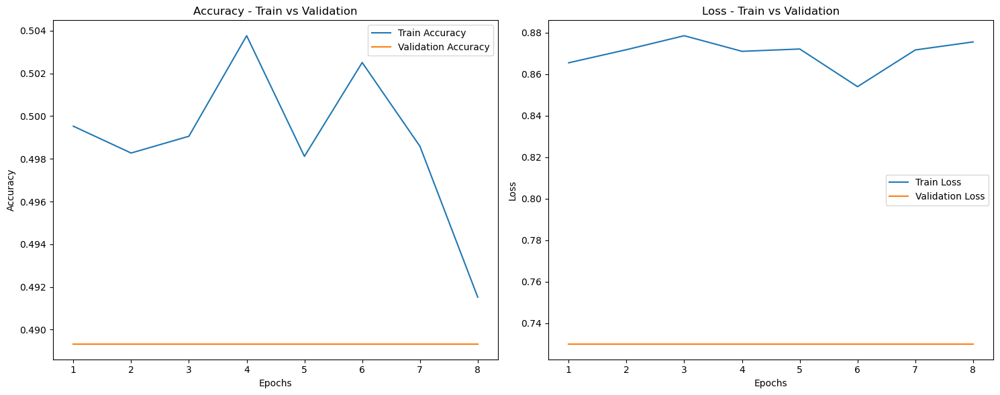

In [ ]:
plot_training_history(history_VGG16_2sec)

### After 4 sec

In [ ]:
model_VGG16_4sec,history_VGG16_4sec = vgg_transfer_model(X_train_4secT, y_train_4secT, X_val_4secT, y_val_4secT, X_test_4secT, y_test_4secT)

Epoch 1/100
82/82 [==============================] - 55s 664ms/step - loss: 0.9168 - accuracy: 0.4896 - val_loss: 0.7337 - val_accuracy: 0.5092
Epoch 2/100
82/82 [==============================] - 54s 663ms/step - loss: 0.9341 - accuracy: 0.4916 - val_loss: 0.7337 - val_accuracy: 0.5092
Epoch 3/100
82/82 [==============================] - 54s 665ms/step - loss: 0.9270 - accuracy: 0.4927 - val_loss: 0.7337 - val_accuracy: 0.5092
Epoch 4/100
82/82 [==============================] - 54s 663ms/step - loss: 0.9302 - accuracy: 0.4708 - val_loss: 0.7337 - val_accuracy: 0.5092
Epoch 5/100
82/82 [==============================] - 54s 664ms/step - loss: 0.9109 - accuracy: 0.5065 - val_loss: 0.7337 - val_accuracy: 0.5092
Epoch 6/100
82/82 [==============================] - 54s 665ms/step - loss: 0.8977 - accuracy: 0.4866 - val_loss: 0.7337 - val_accuracy: 0.5092
Epoch 7/100
82/82 [==============================] - 55s 666ms/step - loss: 0.9031 - accuracy: 0.5061 - val_loss: 0.7337 - val_accuracy:

11/11 [==============================] - 6s 546ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1626,1,1,0,1,0,1
992,2,1,0,0,1,0
1305,3,1,0,0,1,0
1535,4,1,0,0,1,0
1308,5,1,0,0,1,0
...,...,...,...,...,...,...
1082,1995,1,1,0,1,0
65,1996,2,1,0,2,0
804,1997,2,1,0,2,0
803,1998,3,1,0,1,2



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
209,14,1,0,0,1,0
125,34,1,0,1,0,1
214,35,2,0,1,0,2
10,45,1,0,0,1,0
3,54,1,0,0,1,0
...,...,...,...,...,...,...
126,1946,1,1,0,1,0
253,1947,1,1,0,1,0
208,1948,1,1,0,1,0
176,1949,1,1,0,1,0



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
84,0,1,0,1,0,1
254,17,1,0,1,0,1
99,28,1,0,0,1,0
101,29,1,0,0,1,0
256,34,1,0,0,1,0
...,...,...,...,...,...,...
280,1984,1,1,0,1,0
107,1988,1,1,0,1,0
32,1995,1,1,0,1,0
59,1998,2,1,0,2,0


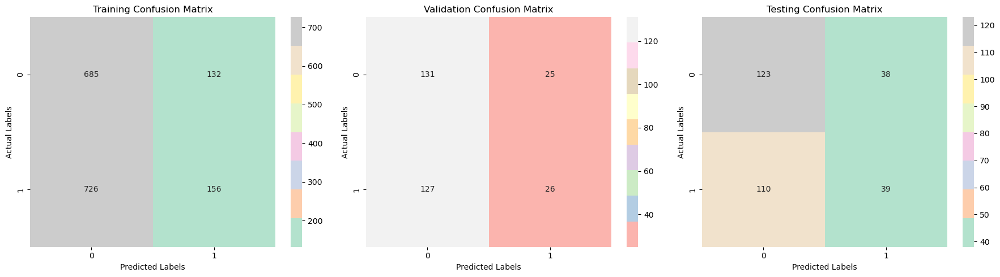

Training Set:
Accuracy: 0.4949970570924073
F1 Score: 0.26666666666666666
Loss: 0.7434638142585754


Validation Set:
Accuracy: 0.5080906148867314
F1 Score: 0.2549019607843137
Loss: 0.7337305545806885


Test Set:
Accuracy: 0.5225806451612903
F1 Score: 0.34513274336283184
Loss: 0.7283775210380554




In [ ]:
VGG16_results_4sec = evaluate_model_video_level(model_VGG16_4sec, X_train_4sec, X_val_4sec, X_test_4sec,
                                          X_train_4secT, y_train_4secT, X_val_4secT, y_val_4secT,X_test_4secT, y_test_4secT)

# Print the results
for set_name, metrics in VGG16_results_4sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


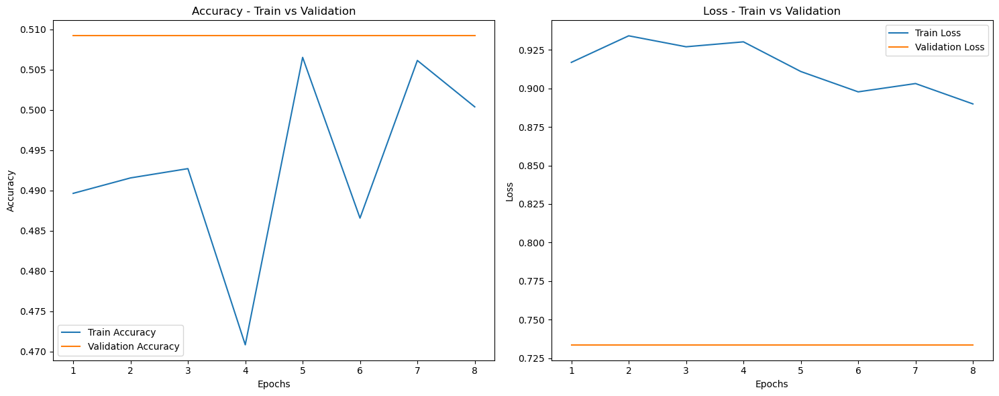

In [ ]:
plot_training_history(history_VGG16_4sec)

# Cross-Validation

In [ ]:
# List to store F1 scores of each model
f1_scores = []

f1_scores.append(Resnet_results_1sec['Test']['F1 Score'])
f1_scores.append(inceptionResNetV2_results_1sec['Test']['F1 Score'])
f1_scores.append(MobileNetV2_results_1sec['Test']['F1 Score'])
f1_scores.append(VGG16_results_1sec['Test']['F1 Score'])

# Model names
model_names = ["ResNet50", "InceptionResNetV2", "MobileNetV2", "VGG16"]

# Create a PrettyTable
table = PrettyTable()
table.field_names = ["Model", "F1 Score"]

# Populate the table
for model_name, f1_score in zip(model_names, f1_scores):
    table.add_row([model_name, f1_score])

# Find the index of the model with the highest F1 score
champion_model_index = np.argmax(f1_scores)
champion_model_name = model_names[champion_model_index]

# Print the F1 scores table and the champion model
print("F1 Scores Table:")
print(table)
print("\nChampion Model:", champion_model_name)


F1 Scores Table:
+-------------------+---------------------+
|       Model       |       F1 Score      |
+-------------------+---------------------+
|      ResNet50     |  0.9721739130434782 |
| InceptionResNetV2 |  0.940550133096717  |
|    MobileNetV2    |  0.972318339100346  |
|       VGG16       | 0.45204178537511874 |
+-------------------+---------------------+

Champion Model: MobileNetV2


In [ ]:
champion_model_index

2

In [ ]:
# Choose the champion model based on the index
champion_model = None

if champion_model_index == 0:
    champion_model = ResNet50   # ResNet50 model
elif champion_model_index == 1:
    champion_model = InceptionResNetV2  #InceptionResNetV2 model
elif champion_model_index == 2:
    champion_model = MobileNetV2   # MobileNetV2 model
elif champion_model_index == 3:
    champion_model = VGG16   #VGG16 model


In [ ]:
champion_model

<function keras.src.applications.mobilenet_v2.MobileNetV2(input_shape=None, alpha=1.0, include_top=True, weights='imagenet', input_tensor=None, pooling=None, classes=1000, classifier_activation='softmax', **kwargs)>

In [ ]:
cross_model=None

if champion_model_index == 0:
    cross_model = ResnetModel_Model   #ResNet50 model
elif champion_model_index == 1:
    cross_model = InceptionResNetV2_Model  #InceptionResNetV2 model
elif champion_model_index == 2:
    cross_model = MobileNetV2_Model   #MobileNetV2 model
elif champion_model_index == 3:
    cross_model = vgg_transfer_model   # VGG16 model

In [ ]:
# Convert y_train_2sec to a one-dimensional array
y_train_1sec = y_train_1sec.squeeze()

# Define the number of folds for cross-validation
n_splits = 5

# Initialize IterativeStratification
iterative_stratified_kfold = IterativeStratification(n_splits=n_splits)

# Initialize an empty dictionary to store the results for each fold
results_per_fold = {}

# Iterate over the folds
for fold, (train_index, val_index) in enumerate(iterative_stratified_kfold.split(X_train_1secT, y_train_1secT)):
    # Convert indices to integers and then to NumPy arrays
    train_index = np.array(train_index, dtype=int)
    val_index = np.array(val_index, dtype=int)

    X_train_fold, X_val_fold = tf.gather(X_train_1secT, train_index), tf.gather(X_train_1secT, val_index)
    y_train_fold, y_val_fold = tf.gather(y_train_1secT, train_index), tf.gather(y_train_1secT, val_index)

    # Call model function with the current fold data
    model, history = cross_model(X_train_fold, y_train_fold, X_val_fold, y_val_fold, X_test_1secT, y_test_1secT)

    # Evaluate the model on the validation set
    y_val_pred = model.predict(X_val_fold)
    y_val_pred_binary = (y_val_pred > 0.5).astype(int)

   # Calculate accuracy and F1 score
accuracy = accuracy_score(y_val_fold, y_val_pred_binary)
f1_val = f1_score(y_val_fold, y_val_pred_binary, average='micro')
  # Change the variable name

# Print the results for the current fold
print(f"Fold {fold + 1} - Accuracy: {accuracy:.4f}, F1 Score: {f1_value:.4f}")


    # Store the trained model and results for later use if needed
results_per_fold[fold] = {'model': model, 'history': history, 'accuracy': accuracy, 'f1_score': f1_val}




Epoch 1/100
66/66 [==============================] - 28s 292ms/step - loss: 0.8579 - accuracy: 0.5369 - val_loss: 0.7798 - val_accuracy: 0.5575
Epoch 2/100
66/66 [==============================] - 21s 313ms/step - loss: 0.5675 - accuracy: 0.7179 - val_loss: 0.8291 - val_accuracy: 0.5613
Epoch 3/100
66/66 [==============================] - 20s 297ms/step - loss: 0.4015 - accuracy: 0.8311 - val_loss: 0.8263 - val_accuracy: 0.5728
Epoch 4/100
66/66 [==============================] - 20s 302ms/step - loss: 0.3181 - accuracy: 0.8704 - val_loss: 0.8016 - val_accuracy: 0.6034
Epoch 5/100
66/66 [==============================] - 20s 306ms/step - loss: 0.2492 - accuracy: 0.9036 - val_loss: 0.8362 - val_accuracy: 0.5728
Epoch 6/100
66/66 [==============================] - 20s 305ms/step - loss: 0.1938 - accuracy: 0.9290 - val_loss: 0.8221 - val_accuracy: 0.6207
Epoch 7/100
66/66 [==============================] - 20s 305ms/step - loss: 0.1390 - accuracy: 0.9482 - val_loss: 0.9788 - val_accuracy:

In [ ]:
# Initialize empty lists to store individual fold accuracies and F1 scores
fold_accuracies = []
fold_f1_scores = []

# Iterate over the folds
for fold, result in results_per_fold.items():
    accuracy = result['accuracy']
    f1_score = result['f1_score']
    fold_accuracies.append(accuracy)
    fold_f1_scores.append(f1_score)
    print(f"Fold {fold + 1} - Accuracy: {accuracy:.4f}, F1 Score: {f1_score:.4f}")

# Calculate and print the average accuracy and F1 score
average_accuracy = np.mean(fold_accuracies)
average_f1_score = np.mean(fold_f1_scores)
print(f"\nAverage Accuracy Across Folds: {average_accuracy:.4f}")
print(f"Average F1 Score Across Folds: {average_f1_score:.4f}")


Fold 5 - Accuracy: 0.5489, F1 Score: 0.5489

Average Accuracy Across Folds: 0.5489
Average F1 Score Across Folds: 0.5489


# Apply Soft Voting

Apply soft voting on the best three models

In [ ]:
def soft_vote(models, data):
    # Predict probabilities for each model
    predictions = [model.predict(data) for model in models]

    # Take the average of predicted probabilities
    avg_predictions = np.mean(predictions, axis=0)

    # Convert probabilities to class labels
    class_labels = np.argmax(avg_predictions, axis=1)

    return class_labels



In [ ]:
X_test_combined = X_test_1secT

# Apply soft voting
soft_voting_predictions = soft_vote([model_resnet50_1sec, model_inceptionResNetV2_1sec, model_MobileNetV2_1sec], X_test_combined)

# Print or use the soft voting predictions
print(soft_voting_predictions)

52/52 [==============================] - 4s 73ms/step
[1 0 0 ... 1 0 0]


In [ ]:
# soft voting predictions stored in soft_voting_predictions
threshold = 0.5

# Apply threshold to get binary predictions
binary_predictions = (soft_voting_predictions > threshold).astype(int)
# Assuming y_true is a TensorFlow tensor
y_true_binary = y_test_1secT.numpy()



In [ ]:
# Assuming y_true_binary is a multilabel-indicator, convert it to a 1D array
y_true_binary = np.argmax(y_true_binary, axis=1)



# Evaluate the model
accuracy = accuracy_score(y_true_binary, binary_predictions)
precision = precision_score(y_true_binary, binary_predictions)
recall = recall_score(y_true_binary, binary_predictions)
f1 = f1_score(y_true_binary, binary_predictions)

# Print or use the evaluation metrics
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)


Accuracy: 0.9712889431887599
Precision: 0.9662243667068757
Recall: 0.9768292682926829
F1 Score: 0.9714978775015161


# Hyperparameter tuning on the Champion Model

### Try to change the learning rate value to 0.001 and 0.00001 instead of 0.0001.

In [ ]:
def MobileNetV2_Model_powerthree(X_train, y_train, X_val, y_val, X_test, y_test, epochs=epochs, batch_size=batch_size):
    # Load the MobileNetV2 model pre-trained on ImageNet
    base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

    # Add custom classification layers on top of MobileNetV2
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)  # Add dropout with a dropout rate of 0.5
    predictions = Dense(2, activation='softmax')(x)

    # Create a new model combining MobileNetV2 base and custom layers
    model = Model(inputs=base_model.input, outputs=predictions)
    custom_optimizer = Adam(learning_rate=0.001)  # Set your desired learning rate here

    # Compile the model
    model.compile(optimizer=custom_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    # Define early stopping criteria
    early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)

    # Train the model with early stopping
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping])

    return model, history


In [ ]:
model_MobileNetV2_1sec,history_MobileNetV2_1sec = MobileNetV2_Model_powerthree(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)

Epoch 1/100
410/410 [==============================] - 132s 301ms/step - loss: 0.6614 - accuracy: 0.6330 - val_loss: 1.4683 - val_accuracy: 0.4899
Epoch 2/100
410/410 [==============================] - 121s 295ms/step - loss: 0.4845 - accuracy: 0.7747 - val_loss: 4.0154 - val_accuracy: 0.4899
Epoch 3/100
410/410 [==============================] - 123s 301ms/step - loss: 0.3729 - accuracy: 0.8479 - val_loss: 1.9262 - val_accuracy: 0.5620
Epoch 4/100
410/410 [==============================] - 119s 291ms/step - loss: 0.2713 - accuracy: 0.8972 - val_loss: 1.5744 - val_accuracy: 0.6390
Epoch 5/100
410/410 [==============================] - 121s 295ms/step - loss: 0.2245 - accuracy: 0.9123 - val_loss: 3.8035 - val_accuracy: 0.5425
Epoch 6/100
410/410 [==============================] - 127s 311ms/step - loss: 0.2045 - accuracy: 0.9225 - val_loss: 1.8041 - val_accuracy: 0.6823
Epoch 7/100
410/410 [==============================] - 127s 310ms/step - loss: 0.1600 - accuracy: 0.9376 - val_loss: 0

52/52 [==============================] - 4s 67ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1941,0,5,0,0,4,1
1420,1,4,0,0,4,0
1085,2,5,0,0,4,1
1715,3,3,0,0,3,0
1570,4,5,0,0,5,0
...,...,...,...,...,...,...
1347,1995,8,1,1,0,8
56,1996,8,1,0,7,1
878,1997,8,1,1,0,8
1555,1998,18,1,1,4,14



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
845,2,2,0,0,2,0
175,3,1,0,1,0,1
1109,8,1,0,0,1,0
580,11,1,0,0,1,0
562,12,1,0,0,1,0
...,...,...,...,...,...,...
854,1995,1,1,1,0,1
254,1996,1,1,0,1,0
118,1997,2,1,1,0,2
860,1998,1,1,0,1,0



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
702,0,2,0,0,2,0
148,1,1,0,0,1,0
1061,4,1,0,0,1,0
591,5,2,0,0,1,1
333,6,1,0,0,1,0
...,...,...,...,...,...,...
134,1994,2,1,1,0,2
845,1995,1,1,1,0,1
209,1996,1,1,0,1,0
131,1998,3,1,0,1,2


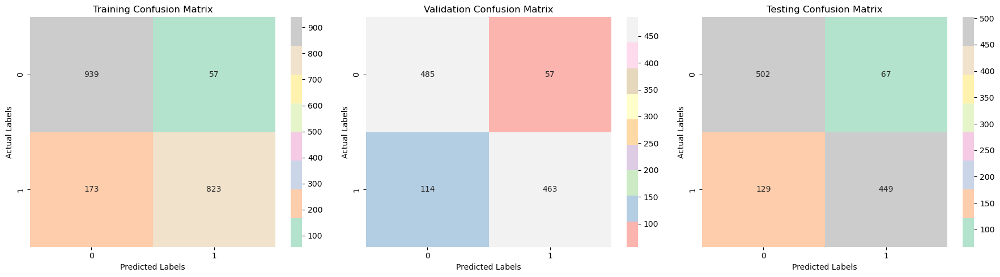

Training Set:
Accuracy: 0.8845381526104418
F1 Score: 0.8773987206823027
Loss: 0.413766473531723


Validation Set:
Accuracy: 0.8471849865951743
F1 Score: 0.8441203281677302
Loss: 0.5593690872192383


Test Set:
Accuracy: 0.8291194420226679
F1 Score: 0.8208409506398537
Loss: 0.6320216059684753




In [ ]:
MobileNetV2_results_1sec_fin1=evaluate_model_video_level(model_MobileNetV2_1sec,X_train_1sec,X_val_1sec,X_test_1sec,
                                        X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT,y_test_1secT)

# Print the results
for set_name, metrics in MobileNetV2_results_1sec_fin1.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


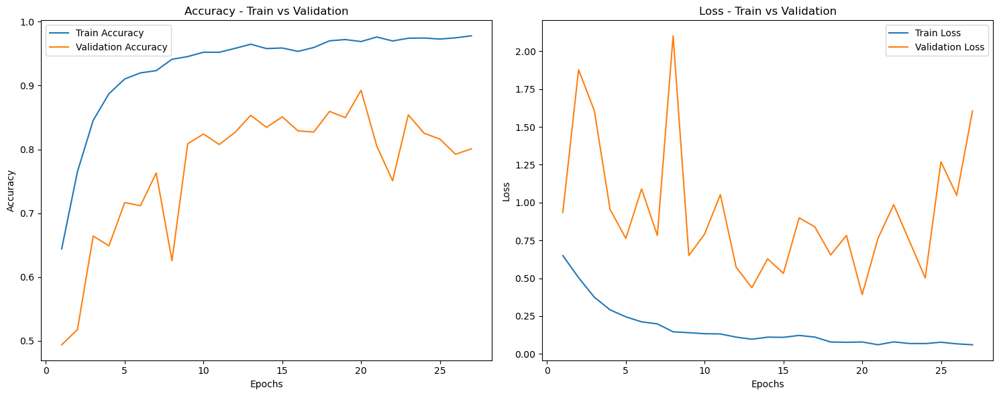

In [ ]:
plot_training_history(historypowerthree_MobileNetV2_1sec)

In [ ]:
def MobileNetV2_Model_five(X_train, y_train, X_val, y_val, X_test, y_test, epochs=epochs, batch_size=batch_size):
    # Load the MobileNetV2 model pre-trained on ImageNet
    base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

    # Add custom classification layers on top of MobileNetV2
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)  # Add dropout with a dropout rate of 0.5
    predictions = Dense(2, activation='softmax')(x)



    # Create a new model combining MobileNetV2 base and custom layers
    model = Model(inputs=base_model.input, outputs=predictions)
    custom_optimizer = Adam(learning_rate=0.00001)  # Set your desired learning rate here

    # Compile the model
    model.compile(optimizer=custom_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    # Define early stopping criteria
    early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)

    # Train the model with early stopping
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping])

    return model, history


In [ ]:
model_MobileNetV2_1sec,history_MobileNetV2_1sec = MobileNetV2_Model_five(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)

Epoch 1/100
410/410 [==============================] - 124s 281ms/step - loss: 0.8167 - accuracy: 0.5512 - val_loss: 0.7486 - val_accuracy: 0.5333
Epoch 2/100
410/410 [==============================] - 115s 280ms/step - loss: 0.6559 - accuracy: 0.6381 - val_loss: 0.6461 - val_accuracy: 0.6249
Epoch 3/100
410/410 [==============================] - 114s 279ms/step - loss: 0.5631 - accuracy: 0.7056 - val_loss: 0.5397 - val_accuracy: 0.7214
Epoch 4/100
410/410 [==============================] - 115s 279ms/step - loss: 0.4862 - accuracy: 0.7633 - val_loss: 0.4444 - val_accuracy: 0.8070
Epoch 5/100
410/410 [==============================] - 114s 279ms/step - loss: 0.4233 - accuracy: 0.8086 - val_loss: 0.3691 - val_accuracy: 0.8558
Epoch 6/100
410/410 [==============================] - 115s 279ms/step - loss: 0.3599 - accuracy: 0.8516 - val_loss: 0.3095 - val_accuracy: 0.8803
Epoch 7/100
410/410 [==============================] - 114s 279ms/step - loss: 0.3113 - accuracy: 0.8750 - val_loss: 0

52/52 [==============================] - 3s 63ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1941,0,5,0,0,5,0
1420,1,4,0,0,4,0
1085,2,5,0,0,5,0
1715,3,3,0,0,3,0
1570,4,5,0,0,5,0
...,...,...,...,...,...,...
1347,1995,8,1,1,0,8
56,1996,8,1,1,0,8
878,1997,8,1,1,0,8
1555,1998,18,1,1,2,16



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
845,2,2,0,0,2,0
175,3,1,0,0,1,0
1109,8,1,0,0,1,0
580,11,1,0,0,1,0
562,12,1,0,0,1,0
...,...,...,...,...,...,...
854,1995,1,1,1,0,1
254,1996,1,1,1,0,1
118,1997,2,1,1,0,2
860,1998,1,1,0,1,0



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
702,0,2,0,0,2,0
148,1,1,0,0,1,0
1061,4,1,0,0,1,0
591,5,2,0,0,2,0
333,6,1,0,0,1,0
...,...,...,...,...,...,...
134,1994,2,1,1,0,2
845,1995,1,1,1,0,1
209,1996,1,1,1,0,1
131,1998,3,1,0,2,1


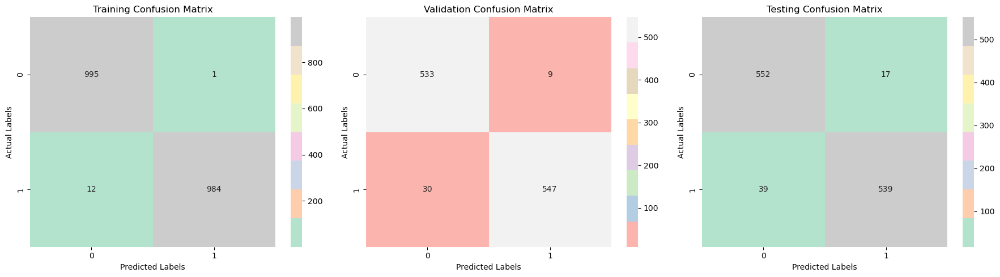

Training Set:
Accuracy: 0.9934738955823293
F1 Score: 0.9934376577486118
Loss: 0.01590590365231037


Validation Set:
Accuracy: 0.9651474530831099
F1 Score: 0.9655781112091791
Loss: 0.1074688732624054


Test Set:
Accuracy: 0.951176983435048
F1 Score: 0.9506172839506173
Loss: 0.12256676703691483




In [ ]:
MobileNetV2_results_1sec_fin2=evaluate_model_video_level(model_MobileNetV2_1sec,X_train_1sec,X_val_1sec,X_test_1sec,
                                        X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT,y_test_1secT)

# Print the results
for set_name, metrics in MobileNetV2_results_1sec_fin2.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


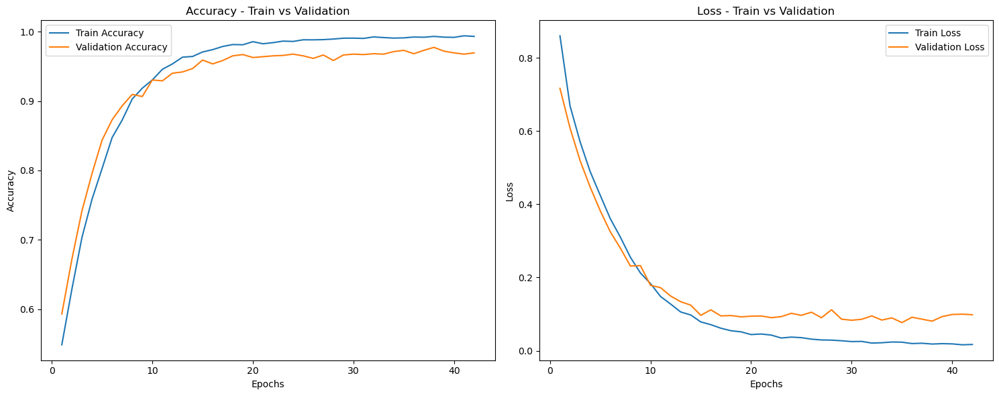

In [ ]:
plot_training_history(history5_MobileNetV2_1sec)

###Try to change the batch size value to 16 and 64 instead of 32.

In [ ]:
def MobileNetV2_Model_64(X_train, y_train, X_val, y_val, X_test, y_test, epochs=epochs, batch_size=64):
    # Load the MobileNetV2 model pre-trained on ImageNet
    base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

    # Add custom classification layers on top of MobileNetV2
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)  # Add dropout with a dropout rate of 0.5
    predictions = Dense(2, activation='softmax')(x)



    # Create a new model combining MobileNetV2 base and custom layers
    model = Model(inputs=base_model.input, outputs=predictions)
    custom_optimizer = Adam(learning_rate=0.0001)  # Set your desired learning rate here

    # Compile the model
    model.compile(optimizer=custom_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    # Define early stopping criteria
    early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)

    # Train the model with early stopping
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping])

    return model, history


In [ ]:
model_MobileNetV2_1sec,history_MobileNetV2_1sec = MobileNetV2_Model_64(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)

Epoch 1/100
205/205 [==============================] - 125s 566ms/step - loss: 0.5620 - accuracy: 0.7143 - val_loss: 0.6808 - val_accuracy: 0.6188
Epoch 2/100
205/205 [==============================] - 115s 560ms/step - loss: 0.2298 - accuracy: 0.9114 - val_loss: 0.6331 - val_accuracy: 0.7013
Epoch 3/100
205/205 [==============================] - 115s 563ms/step - loss: 0.1151 - accuracy: 0.9603 - val_loss: 1.2303 - val_accuracy: 0.6298
Epoch 4/100
205/205 [==============================] - 120s 584ms/step - loss: 0.0776 - accuracy: 0.9714 - val_loss: 2.0974 - val_accuracy: 0.5956
Epoch 5/100
205/205 [==============================] - 117s 572ms/step - loss: 0.0596 - accuracy: 0.9783 - val_loss: 0.7418 - val_accuracy: 0.7789
Epoch 6/100
205/205 [==============================] - 114s 558ms/step - loss: 0.0525 - accuracy: 0.9805 - val_loss: 0.5051 - val_accuracy: 0.8351
Epoch 7/100
205/205 [==============================] - 114s 557ms/step - loss: 0.0509 - accuracy: 0.9813 - val_loss: 0

52/52 [==============================] - 3s 64ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1941,0,5,0,0,5,0
1420,1,4,0,0,4,0
1085,2,5,0,0,5,0
1715,3,3,0,0,3,0
1570,4,5,0,0,5,0
...,...,...,...,...,...,...
1347,1995,8,1,1,0,8
56,1996,8,1,1,0,8
878,1997,8,1,1,2,6
1555,1998,18,1,1,1,17



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
845,2,2,0,0,2,0
175,3,1,0,0,1,0
1109,8,1,0,0,1,0
580,11,1,0,0,1,0
562,12,1,0,0,1,0
...,...,...,...,...,...,...
854,1995,1,1,1,0,1
254,1996,1,1,1,0,1
118,1997,2,1,0,1,1
860,1998,1,1,0,1,0



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
702,0,2,0,0,2,0
148,1,1,0,0,1,0
1061,4,1,0,0,1,0
591,5,2,0,0,2,0
333,6,1,0,0,1,0
...,...,...,...,...,...,...
134,1994,2,1,1,0,2
845,1995,1,1,1,0,1
209,1996,1,1,1,0,1
131,1998,3,1,1,0,3


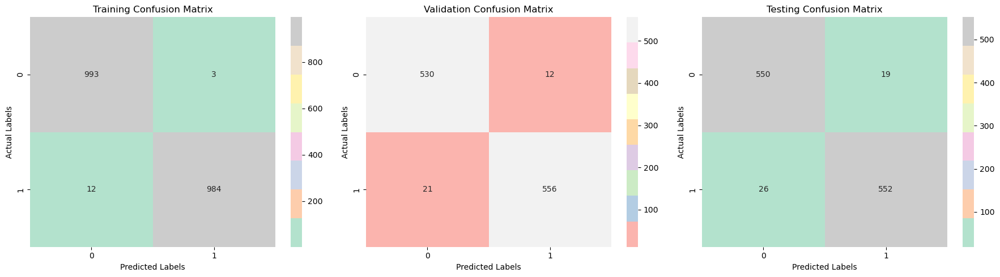

Training Set:
Accuracy: 0.9924698795180723
F1 Score: 0.9924357034795764
Loss: 0.029798710718750954


Validation Set:
Accuracy: 0.9705093833780161
F1 Score: 0.97117903930131
Loss: 0.1136857345700264


Test Set:
Accuracy: 0.960767218831735
F1 Score: 0.9608355091383811
Loss: 0.15138757228851318




In [ ]:
MobileNetV2_results_1sec=evaluate_model_video_level(model_MobileNetV2_1sec,X_train_1sec,X_val_1sec,X_test_1sec,
                                        X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT,y_test_1secT)

# Print the results
for set_name, metrics in MobileNetV2_results_1sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


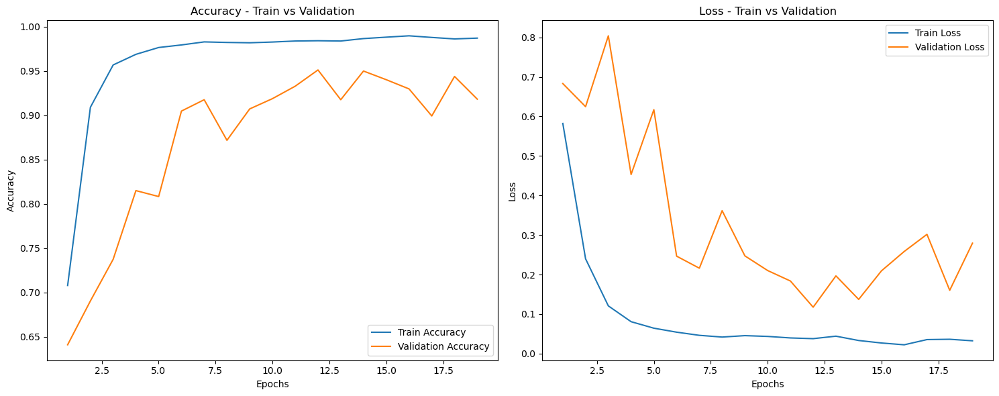

In [ ]:
plot_training_history(history64_MobileNetV2_1sec)

In [ ]:
def MobileNetV2_Model_16(X_train, y_train, X_val, y_val, X_test, y_test, epochs=epochs, batch_size=16):
    # Load the MobileNetV2 model pre-trained on ImageNet
    base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

    # Add custom classification layers on top of MobileNetV2
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)  # Add dropout with a dropout rate of 0.5
    predictions = Dense(2, activation='softmax')(x)



    # Create a new model combining MobileNetV2 base and custom layers
    model = Model(inputs=base_model.input, outputs=predictions)
    custom_optimizer = Adam(learning_rate=0.0001)  # Set your desired learning rate here

    # Compile the model
    model.compile(optimizer=custom_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    # Define early stopping criteria
    early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)

    # Train the model with early stopping
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping])

    return model, history


In [ ]:
model_MobileNetV2_1sec,history_MobileNetV2_1sec = MobileNetV2_Model_16(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)

Epoch 1/100
819/819 [==============================] - 134s 153ms/step - loss: 0.5822 - accuracy: 0.6981 - val_loss: 0.5534 - val_accuracy: 0.6976
Epoch 2/100
819/819 [==============================] - 126s 154ms/step - loss: 0.2975 - accuracy: 0.8773 - val_loss: 0.3172 - val_accuracy: 0.8619
Epoch 3/100
819/819 [==============================] - 124s 151ms/step - loss: 0.1928 - accuracy: 0.9242 - val_loss: 0.3708 - val_accuracy: 0.8436
Epoch 4/100
819/819 [==============================] - 124s 151ms/step - loss: 0.1565 - accuracy: 0.9368 - val_loss: 0.1979 - val_accuracy: 0.9218
Epoch 5/100
819/819 [==============================] - 124s 152ms/step - loss: 0.1313 - accuracy: 0.9472 - val_loss: 0.2473 - val_accuracy: 0.9139
Epoch 6/100
819/819 [==============================] - 124s 152ms/step - loss: 0.1227 - accuracy: 0.9509 - val_loss: 0.1884 - val_accuracy: 0.9230
Epoch 7/100
819/819 [==============================] - 124s 151ms/step - loss: 0.1108 - accuracy: 0.9585 - val_loss: 0

52/52 [==============================] - 4s 70ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1941,0,5,0,0,5,0
1420,1,4,0,0,4,0
1085,2,5,0,0,5,0
1715,3,3,0,0,3,0
1570,4,5,0,0,5,0
...,...,...,...,...,...,...
1347,1995,8,1,1,0,8
56,1996,8,1,1,0,8
878,1997,8,1,1,0,8
1555,1998,18,1,1,2,16



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
845,2,2,0,0,2,0
175,3,1,0,0,1,0
1109,8,1,0,0,1,0
580,11,1,0,0,1,0
562,12,1,0,0,1,0
...,...,...,...,...,...,...
854,1995,1,1,1,0,1
254,1996,1,1,1,0,1
118,1997,2,1,1,0,2
860,1998,1,1,1,0,1



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
702,0,2,0,0,2,0
148,1,1,0,0,1,0
1061,4,1,0,0,1,0
591,5,2,0,0,2,0
333,6,1,0,0,1,0
...,...,...,...,...,...,...
134,1994,2,1,1,0,2
845,1995,1,1,1,0,1
209,1996,1,1,1,0,1
131,1998,3,1,0,1,2


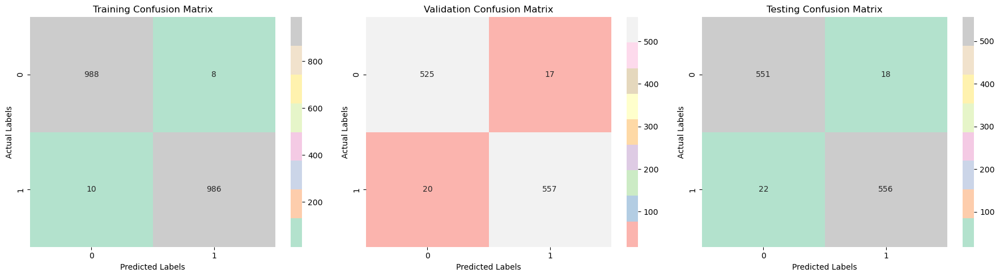

Training Set:
Accuracy: 0.9909638554216867
F1 Score: 0.9909547738693467
Loss: 0.024819178506731987


Validation Set:
Accuracy: 0.966934763181412
F1 Score: 0.9678540399652475
Loss: 0.08776792883872986


Test Set:
Accuracy: 0.96512641673932
F1 Score: 0.9652777777777777
Loss: 0.11953926086425781




In [ ]:
MobileNetV2_results_1sec=evaluate_model_video_level(model_MobileNetV2_1sec,X_train_1sec,X_val_1sec,X_test_1sec,
                                        X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT,y_test_1secT)

# Print the results
for set_name, metrics in MobileNetV2_results_1sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


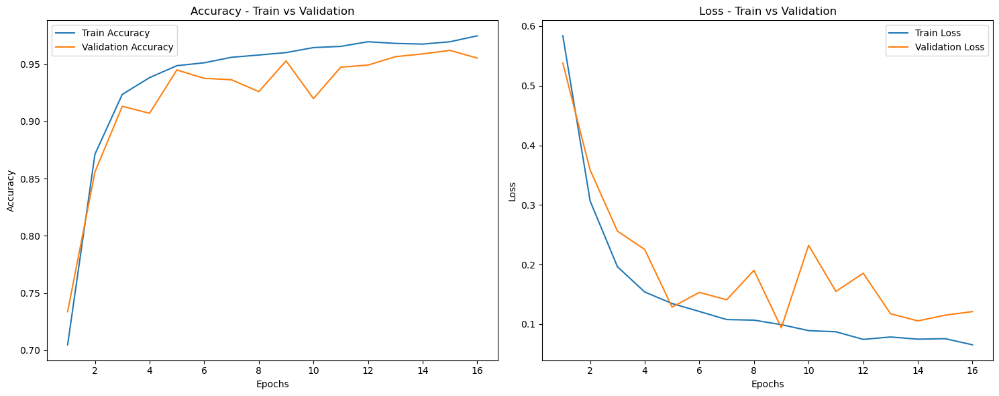

In [ ]:
plot_training_history(history16_MobileNetV2_1sec)

###Try to change the Activation function to be ReLU instead of Softmax.

In [ ]:
# def MobileNetV2_Model_relu(X_train, y_train, X_val, y_val, X_test, y_test, epochs=epochs, batch_size=batch_size):
#     # Load the MobileNetV2 model pre-trained on ImageNet
#     base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

#     # Add custom classification layers on top of MobileNetV2
#     x = base_model.output
#     x = GlobalAveragePooling2D()(x)
#     x = Dense(128, activation='relu')(x)
#     x = Dropout(0.5)(x)  # Add dropout with a dropout rate of 0.5
#     predictions = Dense(2, activation='relu')(x)



#     # Create a new model combining MobileNetV2 base and custom layers
#     model = Model(inputs=base_model.input, outputs=predictions)
#     custom_optimizer = Adam(learning_rate=0.0001)  # Set your desired learning rate here

#     # Compile the model
#     model.compile(optimizer=custom_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

#     # Define early stopping criteria
#     early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)

#     # Train the model with early stopping
#     history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping])

#     return model, history


In [ ]:
model_MobileNetV2_1sec,history_MobileNetV2_1sec = MobileNetV2_Model_relu(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)

Epoch 1/100
410/410 [==============================] - 122s 276ms/step - loss: nan - accuracy: 0.4916 - val_loss: nan - val_accuracy: 0.4899
Epoch 2/100
410/410 [==============================] - 113s 275ms/step - loss: nan - accuracy: 0.4914 - val_loss: nan - val_accuracy: 0.4899
Epoch 3/100
410/410 [==============================] - 113s 275ms/step - loss: nan - accuracy: 0.4914 - val_loss: nan - val_accuracy: 0.4899
Epoch 4/100
410/410 [==============================] - 113s 275ms/step - loss: nan - accuracy: 0.4914 - val_loss: nan - val_accuracy: 0.4899
Epoch 5/100
410/410 [==============================] - 113s 275ms/step - loss: nan - accuracy: 0.4914 - val_loss: nan - val_accuracy: 0.4899
Epoch 6/100
410/410 [==============================] - 113s 275ms/step - loss: nan - accuracy: 0.4914 - val_loss: nan - val_accuracy: 0.4899
Epoch 7/100
410/410 [==============================] - 113s 275ms/step - loss: nan - accuracy: 0.4914 - val_loss: nan - val_accuracy: 0.4899


52/52 [==============================] - 3s 64ms/step


c:\Users\Project\anaconda3\envs\my_env\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Project\anaconda3\envs\my_env\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Training Set:


c:\Users\Project\anaconda3\envs\my_env\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1941,0,5,0,0,5,0
1420,1,4,0,0,4,0
1085,2,5,0,0,5,0
1715,3,3,0,0,3,0
1570,4,5,0,0,5,0
...,...,...,...,...,...,...
1347,1995,8,1,0,8,0
56,1996,8,1,0,8,0
878,1997,8,1,0,8,0
1555,1998,18,1,0,18,0



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
845,2,2,0,0,2,0
175,3,1,0,0,1,0
1109,8,1,0,0,1,0
580,11,1,0,0,1,0
562,12,1,0,0,1,0
...,...,...,...,...,...,...
854,1995,1,1,0,1,0
254,1996,1,1,0,1,0
118,1997,2,1,0,2,0
860,1998,1,1,0,1,0



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
702,0,2,0,0,2,0
148,1,1,0,0,1,0
1061,4,1,0,0,1,0
591,5,2,0,0,2,0
333,6,1,0,0,1,0
...,...,...,...,...,...,...
134,1994,2,1,0,2,0
845,1995,1,1,0,1,0
209,1996,1,1,0,1,0
131,1998,3,1,0,3,0


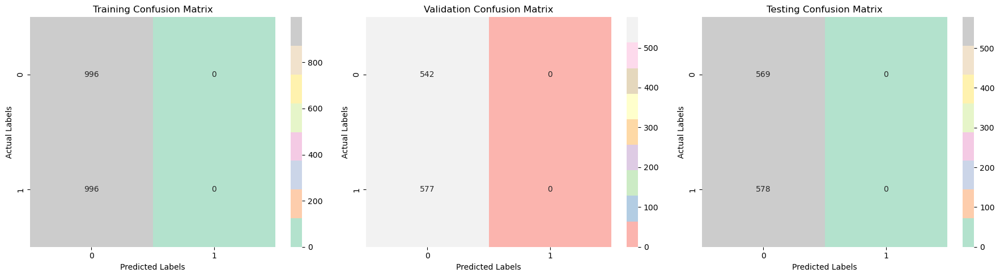

Training Set:
Accuracy: 0.5
F1 Score: 0.0
Loss: nan


Validation Set:
Accuracy: 0.484361036639857
F1 Score: 0.0
Loss: nan


Test Set:
Accuracy: 0.4960767218831735
F1 Score: 0.0
Loss: nan




In [ ]:
MobileNetV2_results_1sec=evaluate_model_video_level(model_MobileNetV2_1sec,X_train_1sec,X_val_1sec,X_test_1sec,
                                        X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT,y_test_1secT)

# Print the results
for set_name, metrics in MobileNetV2_results_1sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


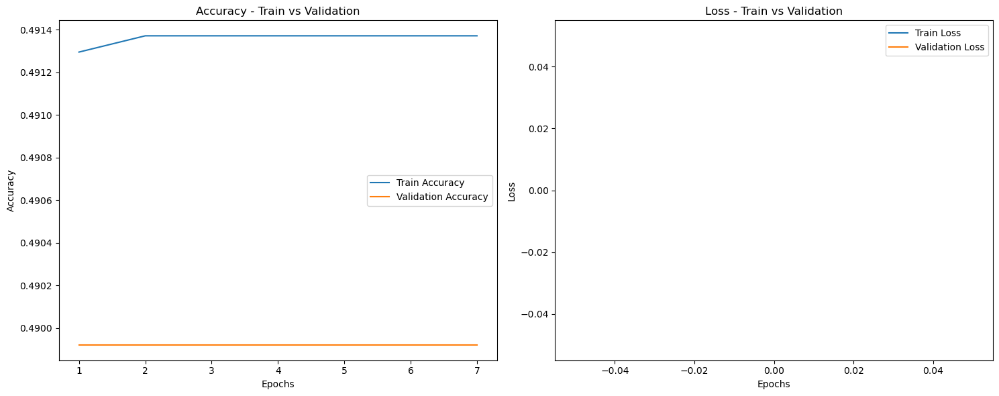

In [ ]:
plot_training_history(history_MobileNetV2_1sec)

###Try to change the number of epochs with no improvement in Early Stopping to be 5 instead of 7.

In [ ]:
def MobileNetV2_Model(X_train, y_train, X_val, y_val, X_test, y_test, epochs=epochs, batch_size=batch_size):
    # Load the MobileNetV2 model pre-trained on ImageNet
    base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

    # Add custom classification layers on top of MobileNetV2
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)  # Add dropout with a dropout rate of 0.5
    predictions = Dense(2, activation='softmax')(x)

    # Create a new model combining MobileNetV2 base and custom layers
    model = Model(inputs=base_model.input, outputs=predictions)
    custom_optimizer = Adam(learning_rate=0.0001)  # Set your desired learning rate here

    # Compile the model
    model.compile(optimizer=custom_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    # Define early stopping criteria
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

    # Train the model with early stopping
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping])

    return model, history


In [ ]:
model_MobileNetV2_1sec,history_MobileNetV2_1sec = MobileNetV2_Model(X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT, y_test_1secT)

Epoch 1/100
410/410 [==============================] - 116s 262ms/step - loss: 0.5699 - accuracy: 0.7133 - val_loss: 0.6525 - val_accuracy: 0.6775
Epoch 2/100
410/410 [==============================] - 107s 260ms/step - loss: 0.2434 - accuracy: 0.9046 - val_loss: 0.6140 - val_accuracy: 0.7208
Epoch 3/100
410/410 [==============================] - 106s 260ms/step - loss: 0.1355 - accuracy: 0.9492 - val_loss: 0.4735 - val_accuracy: 0.8198
Epoch 4/100
410/410 [==============================] - 107s 261ms/step - loss: 0.0992 - accuracy: 0.9621 - val_loss: 0.2144 - val_accuracy: 0.9212
Epoch 5/100
410/410 [==============================] - 106s 259ms/step - loss: 0.0911 - accuracy: 0.9643 - val_loss: 0.9660 - val_accuracy: 0.7172
Epoch 6/100
410/410 [==============================] - 106s 260ms/step - loss: 0.0836 - accuracy: 0.9656 - val_loss: 0.2288 - val_accuracy: 0.9133
Epoch 7/100
410/410 [==============================] - 107s 260ms/step - loss: 0.0804 - accuracy: 0.9673 - val_loss: 0

52/52 [==============================] - 3s 60ms/step
Training Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
1941,0,5,0,0,5,0
1420,1,4,0,0,4,0
1085,2,5,0,0,5,0
1715,3,3,0,0,3,0
1570,4,5,0,0,5,0
...,...,...,...,...,...,...
1347,1995,8,1,1,0,8
56,1996,8,1,1,0,8
878,1997,8,1,1,0,8
1555,1998,18,1,1,0,18



Validation Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
845,2,2,0,0,2,0
175,3,1,0,0,1,0
1109,8,1,0,0,1,0
580,11,1,0,0,1,0
562,12,1,0,0,1,0
...,...,...,...,...,...,...
854,1995,1,1,1,0,1
254,1996,1,1,1,0,1
118,1997,2,1,1,0,2
860,1998,1,1,1,0,1



Test Set:


,VideoID,Number of Frames,Actual Label,Model Decision,Predicted Fake Count,Predicted Real Count
702,0,2,0,0,1,1
148,1,1,0,0,1,0
1061,4,1,0,0,1,0
591,5,2,0,0,2,0
333,6,1,0,0,1,0
...,...,...,...,...,...,...
134,1994,2,1,1,0,2
845,1995,1,1,1,0,1
209,1996,1,1,1,0,1
131,1998,3,1,1,0,3


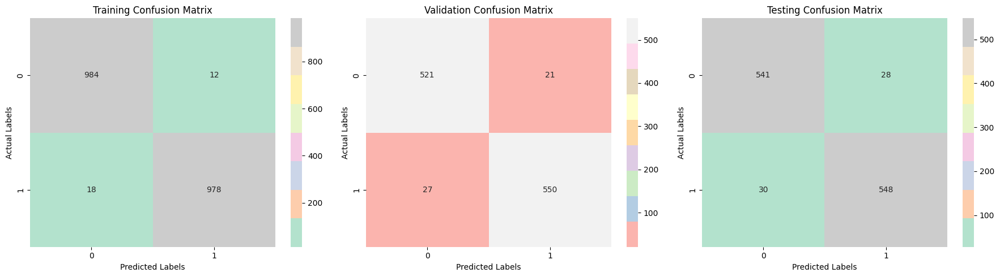

Training Set:
Accuracy: 0.9849397590361446
F1 Score: 0.9848942598187311
Loss: 0.049934566020965576


Validation Set:
Accuracy: 0.9571045576407506
F1 Score: 0.9581881533101045
Loss: 0.14196567237377167


Test Set:
Accuracy: 0.949433304272014
F1 Score: 0.9497400346620452
Loss: 0.16193829476833344




In [ ]:
MobileNetV2_results_1sec=evaluate_model_video_level(model_MobileNetV2_1sec,X_train_1sec,X_val_1sec,X_test_1sec,
                                        X_train_1secT, y_train_1secT, X_val_1secT, y_val_1secT, X_test_1secT,y_test_1secT)

# Print the results
for set_name, metrics in MobileNetV2_results_1sec.items():
    print(f"{set_name} Set:")
    print("Accuracy:", metrics['Accuracy'])
    print("F1 Score:", metrics['F1 Score'])
    print("Loss:", metrics['Loss'])
    print("\n")


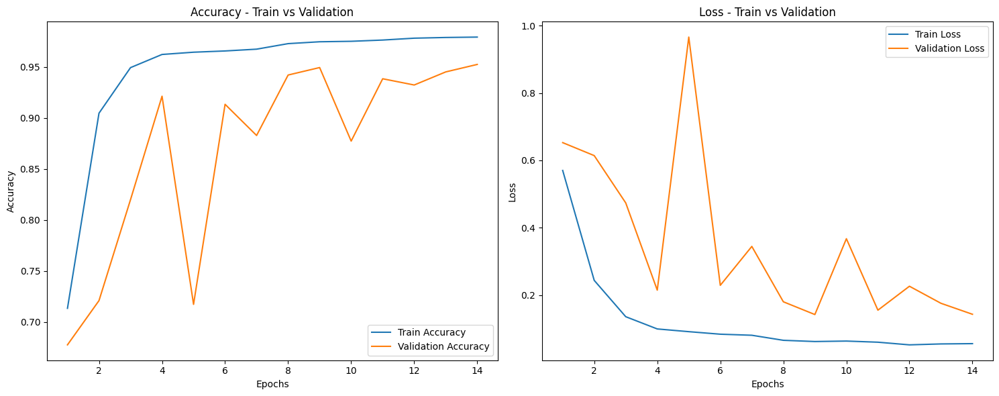

In [ ]:
plot_training_history(history_MobileNetV2_1sec)

In [ ]:
LR_3=np.mean(MobileNetV2_results_1sec_fin1['Test']['F1 Score'])
LR_4=np.mean(MobileNetV2_results_1sec['Test']['F1 Score'])
LR_5=np.mean(MobileNetV2_results_1sec_fin2['Test']['F1 Score'])

# BS_16=np.mean(MobileNetV2_results_1sec['Test']['F1 Score'])
BS_32=np.mean(MobileNetV2_results_1sec['Test']['F1 Score'])
# BS_64=np.mean(MobileNetV2_results_1sec['Test']['F1 Score'])


In [ ]:
#Change Learning Rates
LR_3=0.8208409506398537
LR_4=0.972318339100346
LR_5=0.9506172839506173


#Change Batch Size
BS_16= 0.9652777777777777
BS_32= 0.972318339100346
BS_64= 0.9608355091383811


#change theNumber of epochs on  Early Stops
ES_5= 0.9497400346620452
ER_7=0.972318339100346

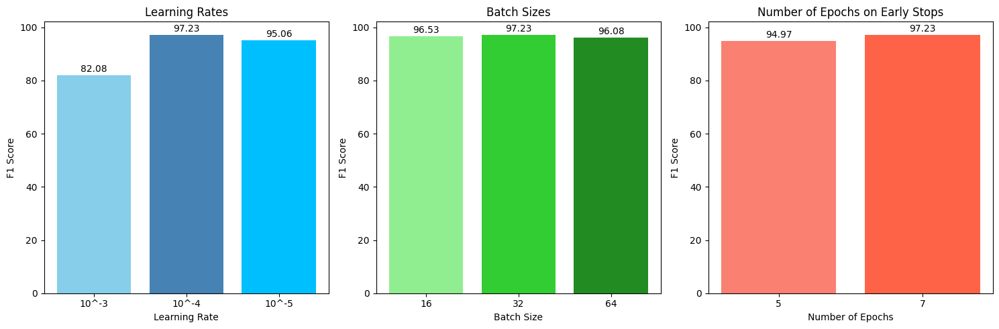

In [ ]:
import matplotlib.pyplot as plt

# Example F1 scores or accuracies for different hyperparameters
LR_scores = [LR_3*100, LR_4*100, LR_5*100]
BS_scores = [BS_16*100, BS_32*100, BS_64*100]
ES_scores = [ES_5*100, ER_7*100]

# Hyperparameters names for x-axis labels
LR_labels = ['10^-3', '10^-4', '10^-5']
BS_labels = ['16', '32', '64']
ES_labels = ['5', '7']

# Define three distinct colors for the columns
colors_LR = ['skyblue', 'steelblue', 'deepskyblue']
colors_BS = ['lightgreen', 'limegreen', 'forestgreen']
colors_ES = ['salmon', 'tomato']

# Create subplots for each hyperparameter type
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Learning Rates comparison
for i, score in enumerate(LR_scores):
    axs[0].bar(LR_labels[i], score, color=colors_LR[i])
    axs[0].text(i, score + 0.5, f'{score:.2f}', ha='center', va='bottom')

axs[0].set_title('Learning Rates')
axs[0].set_xlabel('Learning Rate')
axs[0].set_ylabel('F1 Score')

# Batch Sizes comparison
for i, score in enumerate(BS_scores):
    axs[1].bar(BS_labels[i], score, color=colors_BS[i])
    axs[1].text(i, score + 0.5, f'{score:.2f}', ha='center', va='bottom')

axs[1].set_title('Batch Sizes')
axs[1].set_xlabel('Batch Size')
axs[1].set_ylabel('F1 Score')

# Number of epochs on Early Stops comparison
for i, score in enumerate(ES_scores):
    axs[2].bar(ES_labels[i], score, color=colors_ES[i])
    axs[2].text(i, score + 0.5, f'{score:.2f}', ha='center', va='bottom')

axs[2].set_title('Number of Epochs on Early Stops')
axs[2].set_xlabel('Number of Epochs')
axs[2].set_ylabel('F1 Score')

plt.tight_layout()
plt.show()


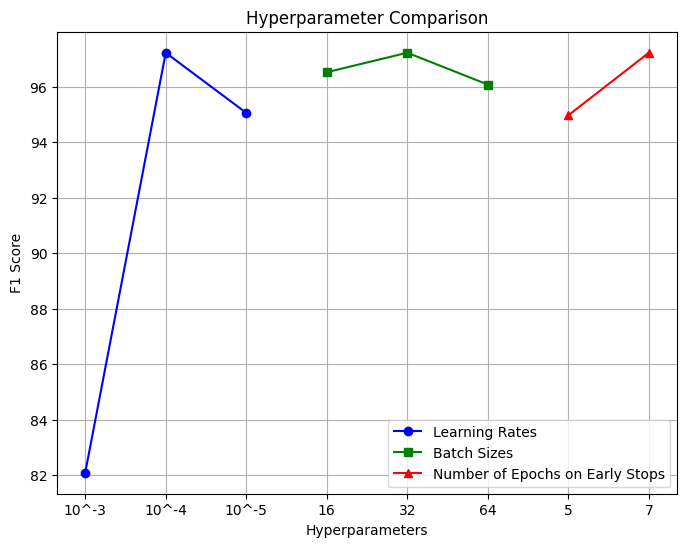

In [ ]:
plt.figure(figsize=(8, 6))

plt.plot(LR_labels, LR_scores, marker='o', color='blue', label='Learning Rates')
plt.plot(BS_labels, BS_scores, marker='s', color='green', label='Batch Sizes')
plt.plot(ES_labels, ES_scores, marker='^', color='red', label='Number of Epochs on Early Stops')

plt.title('Hyperparameter Comparison')
plt.xlabel('Hyperparameters')
plt.ylabel('F1 Score')
plt.legend()
plt.grid(True)
plt.show()


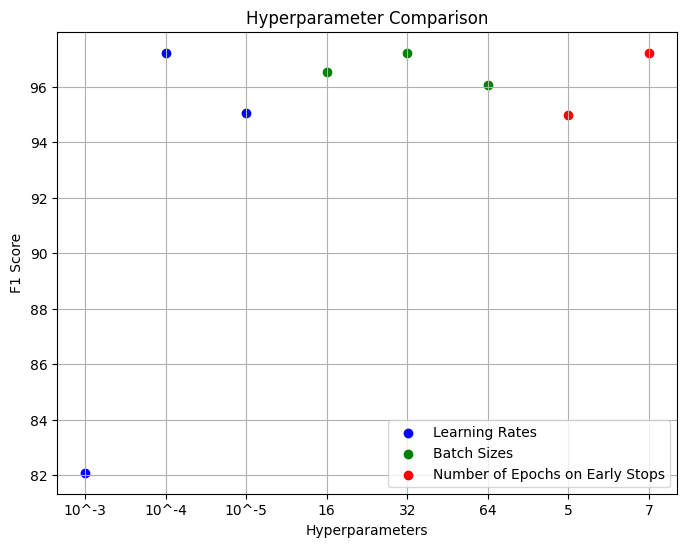

In [ ]:
plt.figure(figsize=(8, 6))

plt.scatter(LR_labels, LR_scores, color='blue', label='Learning Rates')
plt.scatter(BS_labels, BS_scores, color='green', label='Batch Sizes')
plt.scatter(ES_labels, ES_scores, color='red', label='Number of Epochs on Early Stops')

plt.title('Hyperparameter Comparison')
plt.xlabel('Hyperparameters')
plt.ylabel('F1 Score')
plt.legend()
plt.grid(True)
plt.show()


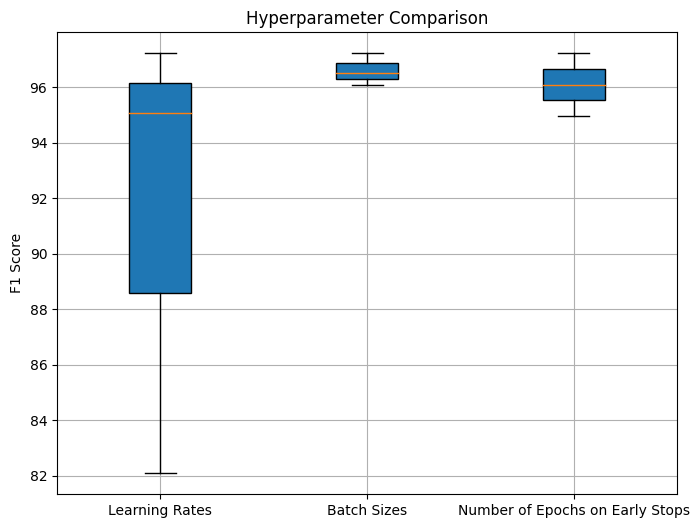

In [ ]:
data = [LR_scores, BS_scores, ES_scores]
labels = ['Learning Rates', 'Batch Sizes', 'Number of Epochs on Early Stops']

plt.figure(figsize=(8, 6))

plt.boxplot(data, labels=labels, patch_artist=True)
plt.title('Hyperparameter Comparison')
plt.ylabel('F1 Score')
plt.grid(True)
plt.show()


# Models Comparision

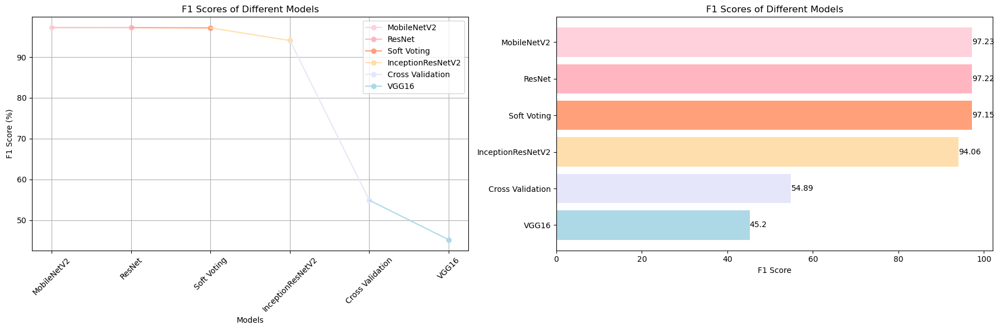

In [ ]:
# List to store F1 scores of each model
Resnet_test_f1_score = np.mean(Resnet_results_1sec['Test']['F1 Score'])
eptiinconResNetV2_test_f1_score = np.mean(inceptionResNetV2_results_1sec['Test']['F1 Score'])
MobileNetV2_test_f1_score = np.mean(MobileNetV2_results_1sec['Test']['F1 Score'])
VGG16_test_f1_score = np.mean(VGG16_results_1sec['Test']['F1 Score'])

average_f1_score_cross = np.mean(average_f1_score)
f1_soft = np.mean(f1)

# Create a dictionary with the mean F1 scores multiplied by 100 for percentage representation
f1_scores = {
    'ResNet': Resnet_test_f1_score * 100,
    'InceptionResNetV2': eptiinconResNetV2_test_f1_score * 100,
    'MobileNetV2': MobileNetV2_test_f1_score * 100,
    'VGG16': VGG16_test_f1_score * 100,
    'Cross Validation': average_f1_score_cross * 100,
    'Soft Voting': f1_soft * 100
}

# Sort the dictionary by values (F1 scores) in descending order
sorted_f1_scores = dict(sorted(f1_scores.items(), key=lambda item: item[1], reverse=True))

# Extract labels and scores for plotting
labels = list(sorted_f1_scores.keys())
scores = list(sorted_f1_scores.values())

# Define pastel colors for each line in the line chart
pastel_colors = ['#FFD1DC', '#FFB6C1', '#FFA07A', '#FFDEAD', '#E6E6FA', '#ADD8E6']

# Create a figure with two subplots
fig, axs = plt.subplots(1, 2, figsize=(18, 6))

# Line chart
for i in range(len(labels)):
    axs[0].plot(labels[i], scores[i], marker='o', linestyle='-', color=pastel_colors[i], label=labels[i])
    if i > 0:
        axs[0].plot([labels[i-1], labels[i]], [scores[i-1], scores[i]], color=pastel_colors[i])

axs[0].set_xlabel('Models')
axs[0].set_ylabel('F1 Score (%)')
axs[0].set_title('F1 Scores of Different Models')
axs[0].tick_params(axis='x', rotation=45)
axs[0].legend()
axs[0].grid(True)

# Horizontal bar chart
bars = axs[1].barh(labels, scores, color=pastel_colors)
axs[1].set_xlabel('F1 Score')
axs[1].set_title('F1 Scores of Different Models')
axs[1].invert_yaxis()  # Invert y-axis for descending order

# Add labels to each bar
for bar, label in zip(bars, labels):
    axs[1].text(bar.get_width(), bar.get_y() + bar.get_height() / 2, round(bar.get_width(), 2),
             va='center', ha='left')

# Adjust layout to prevent overlapping
plt.tight_layout()

# Show the combined plot
plt.show()


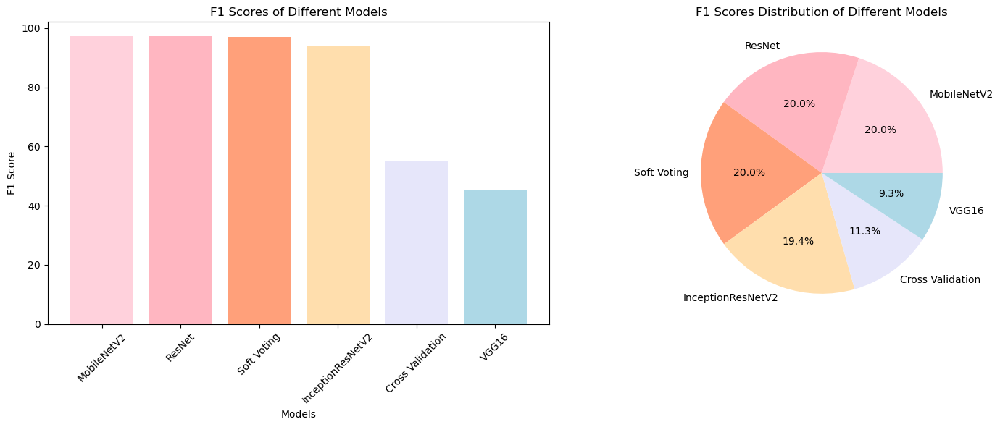

In [ ]:
f1_scores = {
    'ResNet': Resnet_test_f1_score * 100,
    'InceptionResNetV2': eptiinconResNetV2_test_f1_score * 100,
    'MobileNetV2': MobileNetV2_test_f1_score * 100,
    'VGG16': VGG16_test_f1_score * 100,
    'Cross Validation': average_f1_score_cross * 100,
    'Soft Voting': f1_soft * 100
}

# Sort the dictionary by values (F1 scores) in descending order
sorted_f1_scores = dict(sorted(f1_scores.items(), key=lambda item: item[1], reverse=True))

# Extract labels and scores for plotting
labels = list(sorted_f1_scores.keys())
scores = list(sorted_f1_scores.values())

# Create the vertical bar chart with pastel colors
plt.figure(figsize=(15, 6))

# Plot the bar chart
plt.subplot(1, 2, 1)
plt.bar(labels, scores, color=['#FFD1DC', '#FFB6C1', '#FFA07A', '#FFDEAD', '#E6E6FA', '#ADD8E6'])
plt.xlabel('Models')
plt.ylabel('F1 Score')
plt.title('F1 Scores of Different Models')
plt.xticks(rotation=45)

# Plot the pie chart
plt.subplot(1, 2, 2)
plt.pie(scores, labels=labels, autopct='%1.1f%%', colors=['#FFD1DC', '#FFB6C1', '#FFA07A', '#FFDEAD', '#E6E6FA', '#ADD8E6'])
plt.title('F1 Scores Distribution of Different Models')

# Adjust layout
plt.tight_layout()

# Show the combined plot
plt.show()


And as shown in the previous results, the MobileNetV2 model with epochs = 41, batch size =32, learning rate = 0.0001, activation function = Softmax,and patience = 7 is the best model.